In [17]:
source("~/source_all.R")

In [2]:
setwd("/data/work/Projects/STU/230726_DiCarvalho_Cytassist/")
dir.create("250131")
setwd("250131")

In [5]:
#system("cp ../SpotClean_res.RDS .")

In [6]:
#### Global variables ####
dir = "/data/work/Projects/STU/230726_DiCarvalho_Cytassist//"
#Cellranger mode
mode="count"
#Analysis name (will be reflected everywhere)
analysisname="Carvalho"
app.username="carvalholab"
app.password="fksni"
use_decontx.counts = F
#Plot size
options(repr.plot.width=8, repr.plot.height=8)
#Filtering parameters
folders = list.files(path=dir, pattern="SR210$",full.names=T)
samplenames = c("NR1","NR3-4.1","NR3-4.2","NR6")
seur_obj = load_visium(folders,samplenames = samplenames)
if(!file.exists("SpotClean_res.RDS")){
    
    decont = run_spotclean(folders,spaceranger = 2)
    seur_obj = add_contamination_visium(seur_obj,decont,folders)
}else{
    decont = readRDS("SpotClean_res.RDS")
    contamination = unlist(sapply(seq(1, length(decont)), function(x) {
        contam = metadata(decont[[x]])$contamination_rate
        names(contam) = paste(folders[x], names(contam), sep = "_")
        return(contam)
    }, simplify = F))
    names(contamination) = NULL
    seur_obj$Contamination = contamination
}

In [7]:
#Ensure names match
common.genes = Reduce(intersect,lapply(decont, function(x) rownames(x)))
#Get Spotclean counts - Merge only common genes
spotclean_counts.list = lapply(decont, function(x) round(assay(x))[common.genes,])
#Make sure column names are separate and according to sample
spotclean_counts.list = sapply(seq(1,length(samplenames)), function(x){
    y = spotclean_counts.list[[x]]
    colnames(y) = paste(samplenames[x],colnames(y),sep="_")
    return(y)
    },simplify=F
)
spotclean_counts = do.call(cbind, spotclean_counts.list)
seur_obj[["RNA2"]] = CreateAssay5Object(spotclean_counts)
DefaultAssay(seur_obj) = "RNA2"
seur_obj[["RNA"]] = NULL
seur_obj[["RNA"]] = seur_obj[["RNA2"]]
DefaultAssay(seur_obj) = "RNA"
seur_obj[["RNA2"]] = NULL

Warning message:
“Cannot find cell-level meta data named  RNA”
Warning message:
“Key ‘rna2_’ taken, using ‘rna_’ instead”


In [8]:
seur_obj = JoinLayers(seur_obj, assay="Spatial")
seur_obj$nFeature_RNA = seur_obj$nFeature_RNA2
seur_obj$nCount_RNA = seur_obj$nCount_RNA2
Idents(seur_obj) = seur_obj$Sample
seur_obj$log_nCount_Spatial = log2(seur_obj$nCount_Spatial)
seur_obj$log_nFeature_Spatial = log2(seur_obj$nFeature_Spatial)

Misc(seur_obj,"mito_thres") = 0.2
Misc(seur_obj,"ribo_thres") = 100
Misc(seur_obj,"count_thres_min") = 600
Misc(seur_obj,"feature_thres_min") = 400
Misc(seur_obj,"count_thres_max") = Inf
Misc(seur_obj,"feature_thres_max") = Inf
Misc(seur_obj,"contam_thres") = 0.75

seur_obj$percent_mito=0
seur_obj$percent_ribo=0

seur_obj = filter_seur_obj(seur_obj)


Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV o

Running SCTransform on assay: RNA

Running SCTransform on layer: counts.NR1

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 8328 by 3445

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 3445 cells

Found 25 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 8328 genes

Computing corrected count matrix for 8328 genes

Calculating gene attributes

Wall clock passed: Time difference of 23.23986 secs

Determine variable features

Centering data matrix

Running SCTransform on layer: counts.NR3-4.1

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 8328 by 2214

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2214 cells

Found 202 outlie

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10665
Number of edges: 363201

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9520
Number of communities: 8
Elapsed time: 0 seconds


Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10665
Number of edges: 370869

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9365
Number of communities: 8
Elapsed time: 0 seconds


Found 4 SCT models. Recorrecting SCT counts using minimum median counts: 3406

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10665
Number of edges: 359148

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9116
Number of communities: 7
Elapsed time: 0 seconds


Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10665
Number of edges: 387102

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9000
Number of communities: 6
Elapsed time: 1 seconds


Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10665
Number of edges: 346604

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9391
Number of communities: 11
Elapsed time: 0 seconds


Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 10665
Number of edges: 353869

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9155
Number of communities: 7
Elapsed time: 0 seconds
                orig.ident SCT_clusters integrated_clusters harmony_clusters
integratedcca_1  0.5046898     54.93699            54.83059         58.18922
integratedcca_2  0.2563200     42.84158            23.81801         51.79819
integratedcca_3  0.7042408     26.70559            23.54515         45.33197
integratedcca_4  0.1142042     25.42197            20.59282         25.23432
integratedcca_5  0.1296368     13.26291            17.51775         20.23754
integratedcca_6  0.3480110     24.35685            41.63864         28.43993
                harmonysct_clusters RNA_clusters   nCount_SCT cca_clusters
integratedcca_1            56.29249    17.929204 9.743629e-06     74.31075
integratedcca_2            39.07229     9.059608 1.479207e-01    

No id variables; using all as measure variables

No id variables; using all as measure variables

No id variables; using all as measure variables

No id variables; using all as measure variables

No id variables; using all as measure variables

No id variables; using all as measure variables



[1] "RNA silhouette"
         0     1     2     3    4     5     6     7
[1,] 0.433 0.083 0.444 0.481 0.13 0.253 0.411 0.473
[1] "SCT silhouette"
         0      1      2     3      4      5     6      7      8     9    10
[1,] 0.385 -0.191 -0.065 0.315 -0.166 -0.183 0.118 -0.221 -0.136 0.017 0.008
[1] "Harmony silhouette"
        0     1     2     3     4     5     6     7
[1,] 0.34 0.491 0.144 0.217 0.569 0.302 0.274 0.288
[1] "HarmonySCT silhouette"
         0      1     2      3      4     5     6
[1,] 0.212 -0.133 0.232 -0.103 -0.022 0.032 0.271
[1] "Integrated silhouette"
         0     1      2      3     4     5     6
[1,] 0.244 0.033 -0.059 -0.015 0.098 0.271 0.062
[1] "CCA silhouette"
         0     1     2     3      4     5
[1,] 0.413 0.123 0.095 0.084 -0.179 0.259


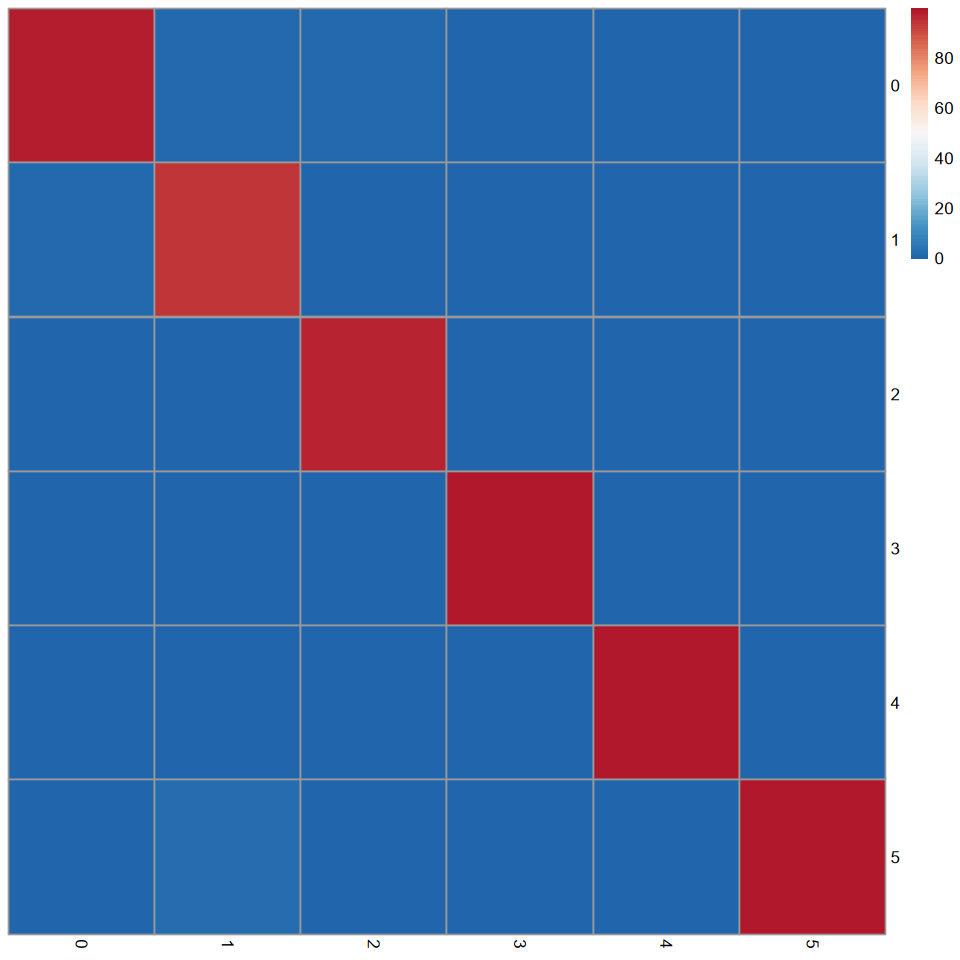

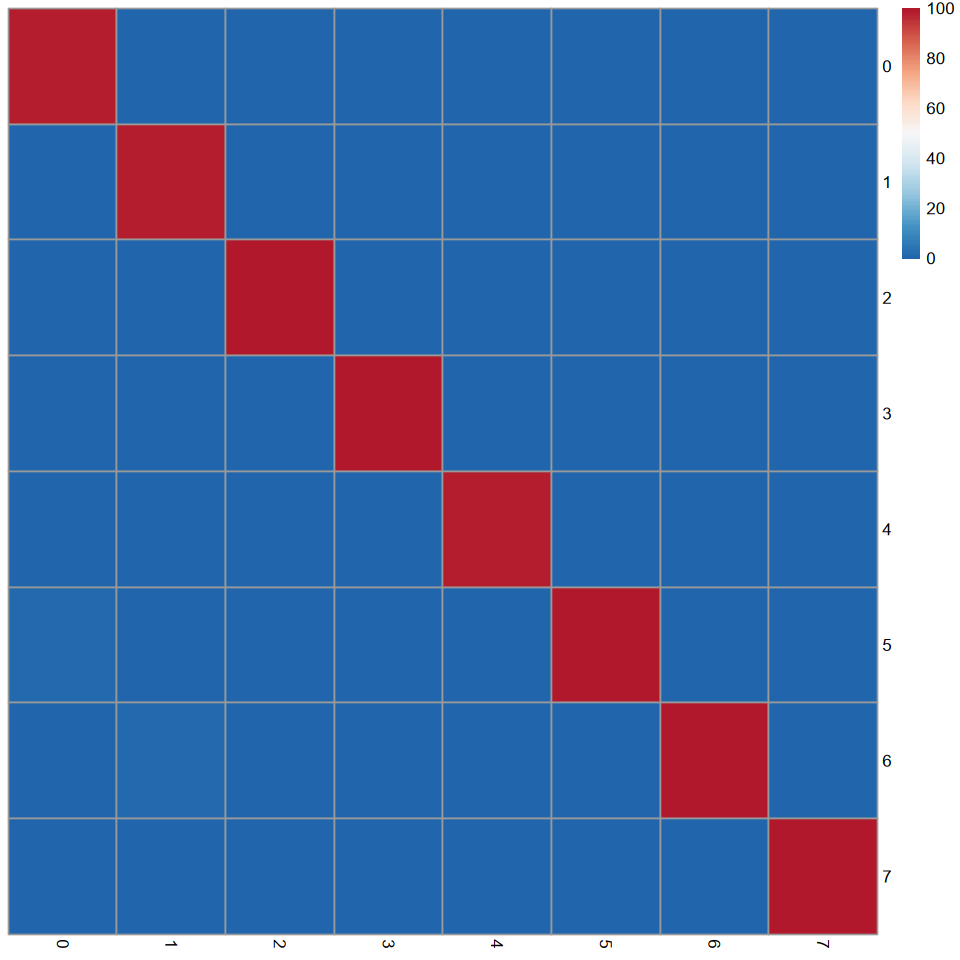

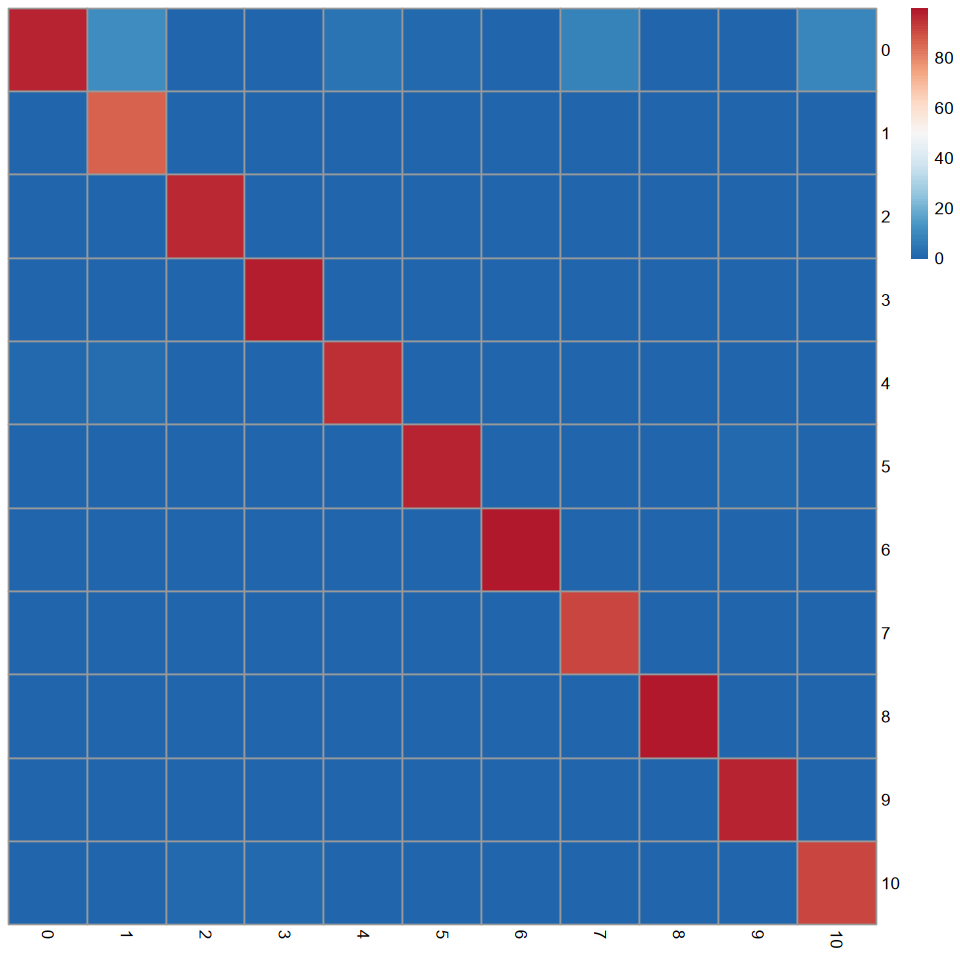

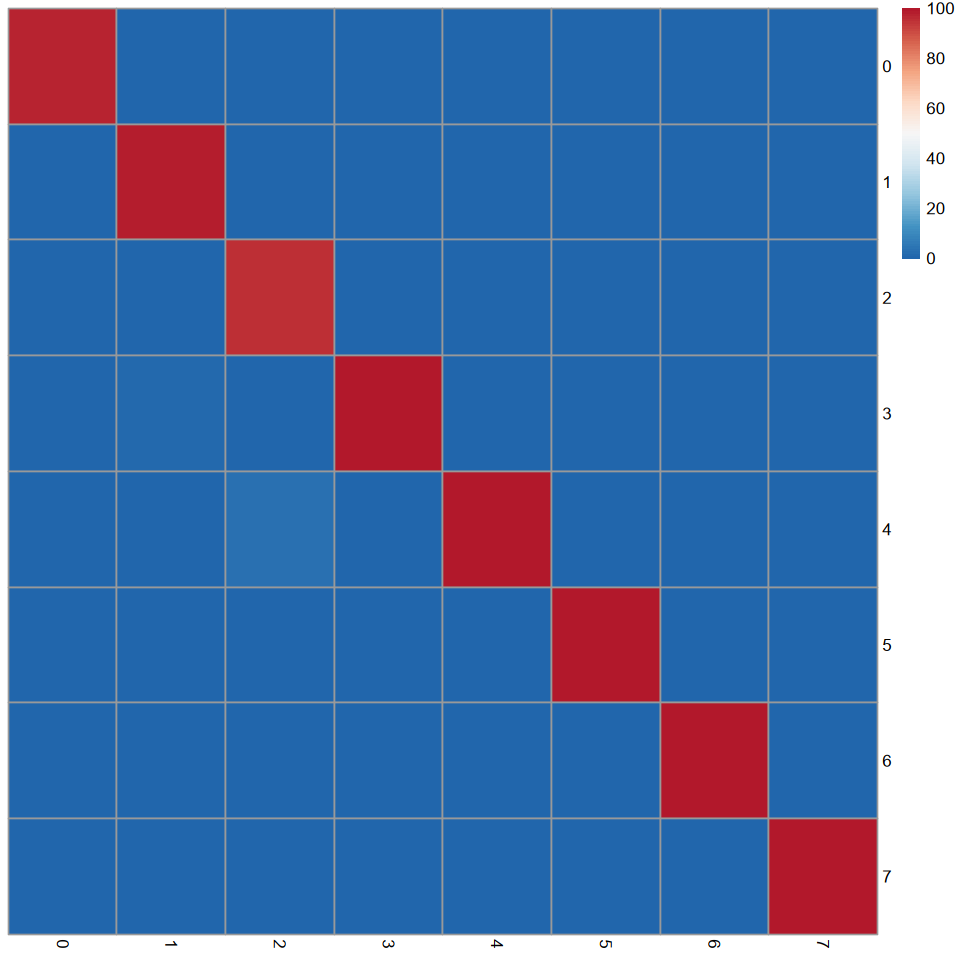

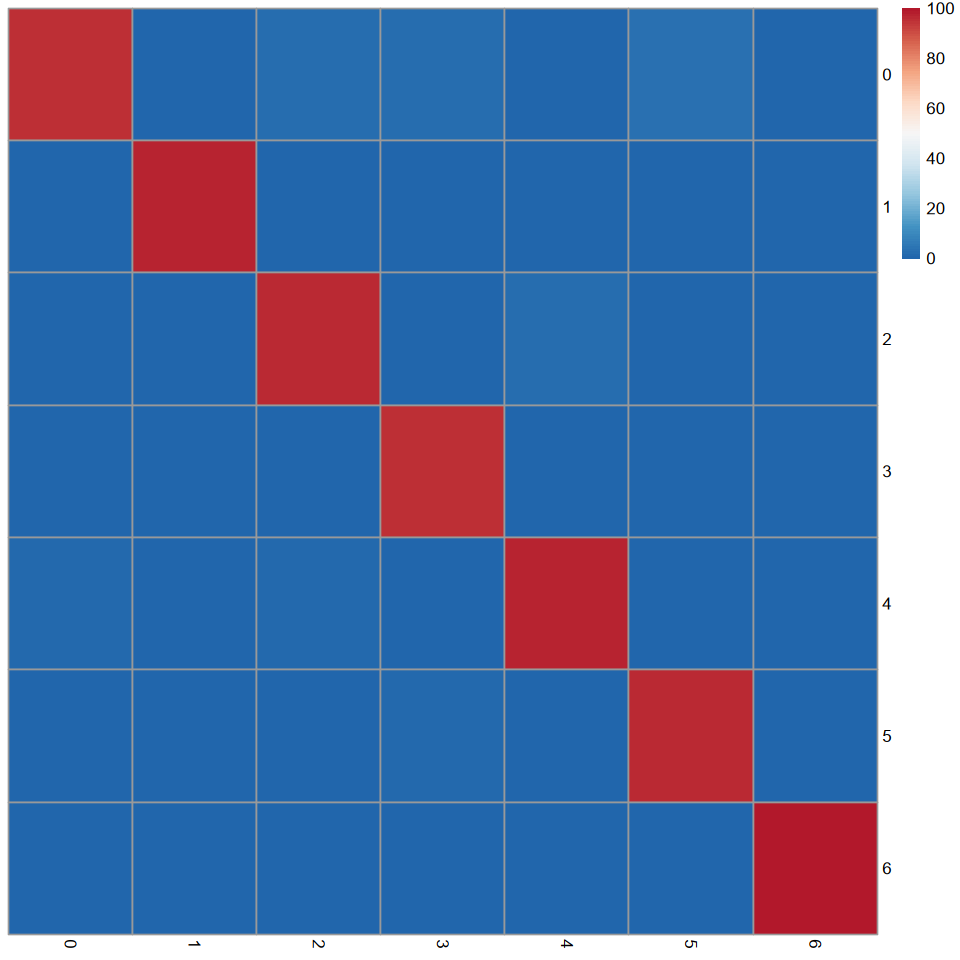

[1] "RNA NMI: 0.764083921579893"
[1] "SCT NMI: 0.64748821891202"
[1] "Harmony NMI: 0.41166483387873"
[1] "Harmony SCT NMI: 0.259876561099471"
[1] "Integration NMI: 0.335817933984947"
[1] "CCA NMI: 0.0240203059979398"


Warning message in system(paste("python ~/run_scib.py", getwd(), cluster_name, batch_name, :
“running command 'python ~/run_scib.py /data/work/Projects/STU/230726_DiCarvalho_Cytassist/250131 integrated_clusters Sample 15' had status 1”


Time difference of 2.324153 secs


Warning message in dir.create("Output"):
“'Output' already exists”
Warning message in system(paste("python ~/run_scib.py", getwd(), cluster_name, batch_name, :
“running command 'python ~/run_scib.py /data/work/Projects/STU/230726_DiCarvalho_Cytassist/250131 RNA_clusters Sample 15' had status 1”


Time difference of 1.271133 secs


Warning message in dir.create("Output"):
“'Output' already exists”
Warning message in system(paste("python ~/run_scib.py", getwd(), cluster_name, batch_name, :
“running command 'python ~/run_scib.py /data/work/Projects/STU/230726_DiCarvalho_Cytassist/250131 SCT_clusters Sample 15' had status 1”


Time difference of 1.173325 secs


Warning message in dir.create("Output"):
“'Output' already exists”
Warning message in system(paste("python ~/run_scib.py", getwd(), cluster_name, batch_name, :
“running command 'python ~/run_scib.py /data/work/Projects/STU/230726_DiCarvalho_Cytassist/250131 harmony_clusters Sample 15' had status 1”


Time difference of 0.8701963 secs


Warning message in dir.create("Output"):
“'Output' already exists”
Warning message in system(paste("python ~/run_scib.py", getwd(), cluster_name, batch_name, :
“running command 'python ~/run_scib.py /data/work/Projects/STU/230726_DiCarvalho_Cytassist/250131 harmonysct_clusters Sample 15' had status 1”


Time difference of 0.7940645 secs
$kBET_score_integrated.rpca_integrated_clusters
character(0)
attr(,"status")
[1] 1
attr(,"errmsg")
[1] "Resource temporarily unavailable"

$kBET_score_RNA_PCA_RNA_clusters
character(0)
attr(,"status")
[1] 1
attr(,"errmsg")
[1] "Resource temporarily unavailable"

$kBET_score_SCT_PCA_SCT_clusters
character(0)
attr(,"status")
[1] 1
attr(,"errmsg")
[1] "Resource temporarily unavailable"

$kBET_score_harmony_harmony_clusters
character(0)
attr(,"status")
[1] 1
attr(,"errmsg")
[1] "Resource temporarily unavailable"

$kBET_score_harmonysct_harmonysct_clusters
character(0)
attr(,"status")
[1] 1
attr(,"errmsg")
[1] "Resource temporarily unavailable"

list()


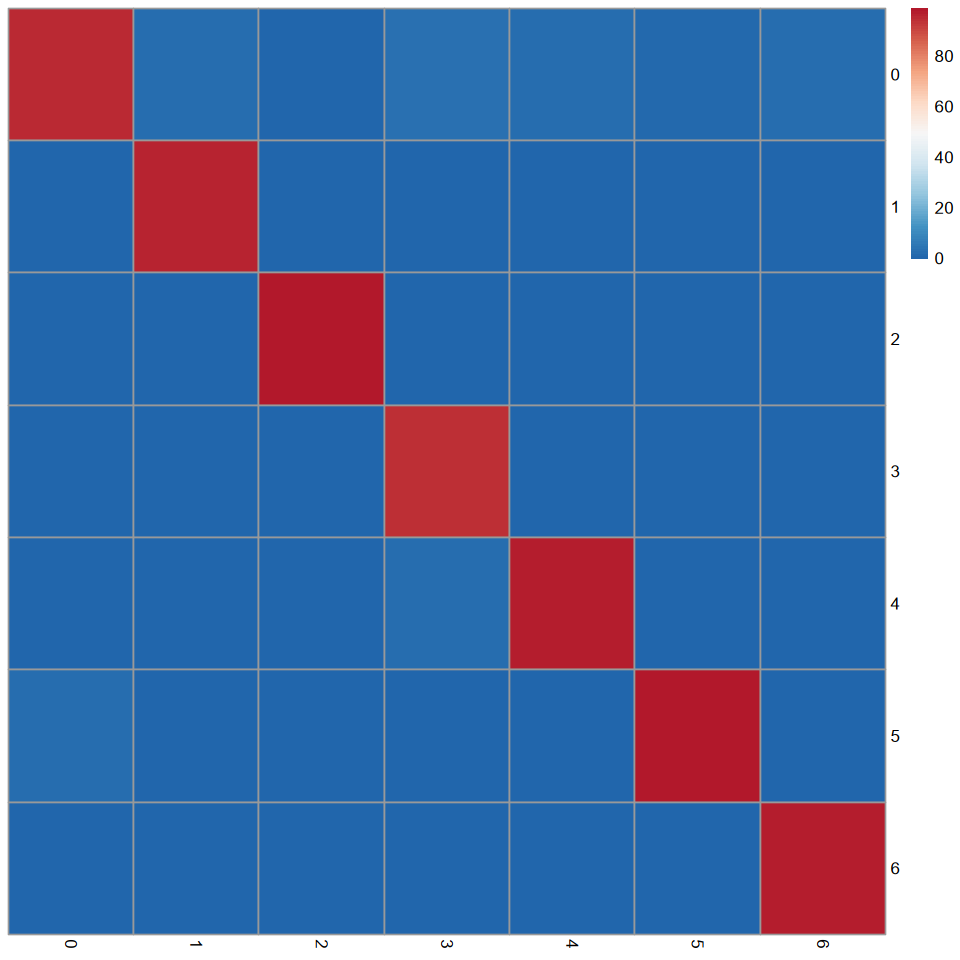

In [9]:
seur_obj$orig.ident = seur_obj$Sample = seur_obj$Batch
seur_obj = run_integration_v5(seur_obj,run_cca = T,dims = 15)
seur_obj = run_quick_qc(seur_obj,dims = 15,res = 0.2)

In [21]:
Misc(seur_obj,"Analysisname") = "FilipeCarvalhoJanuary2025"

Warning message:
“Overwriting miscellanous data for Analysisname”


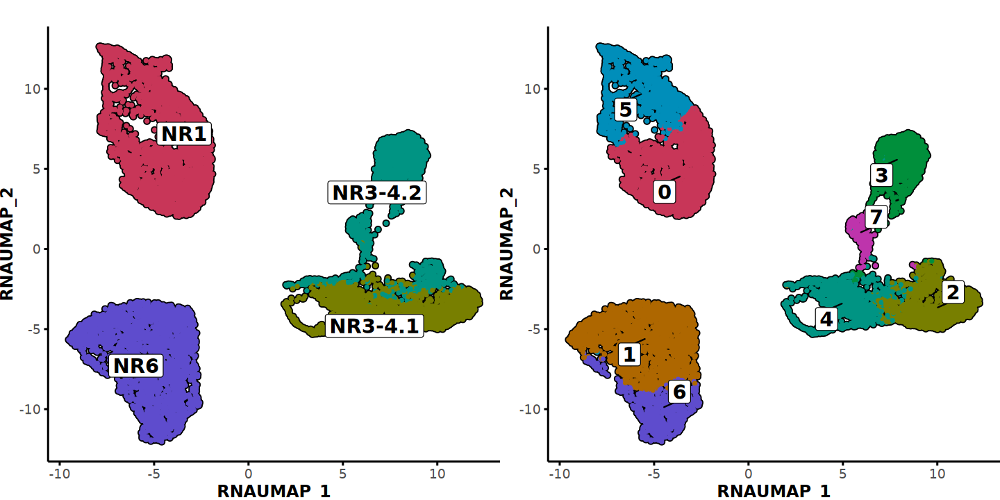

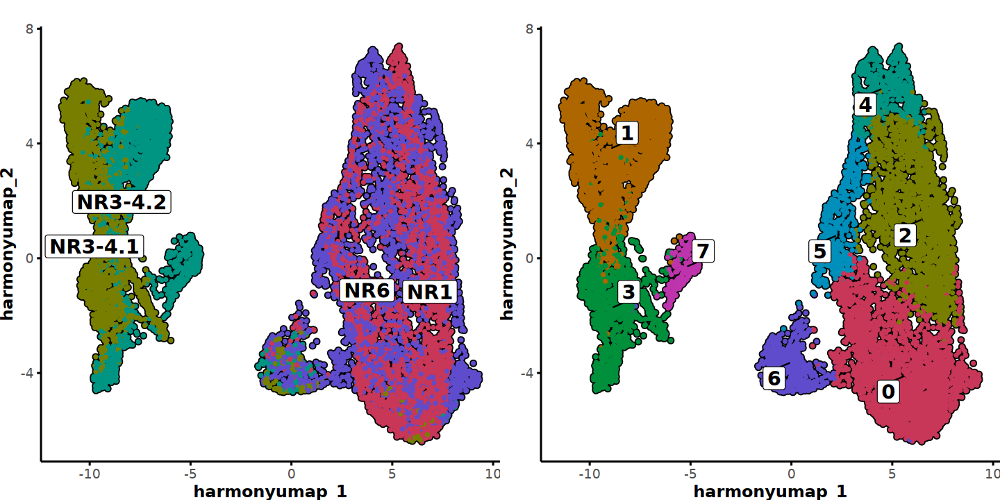

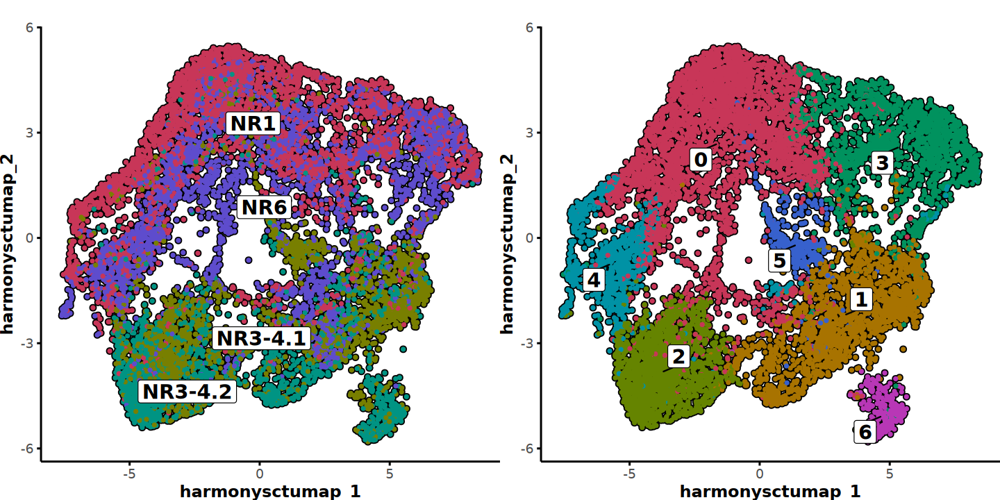

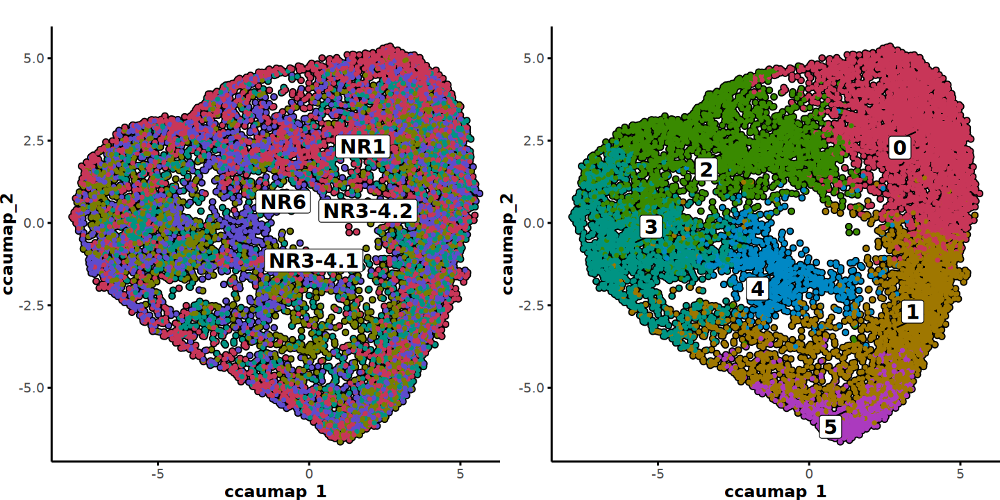

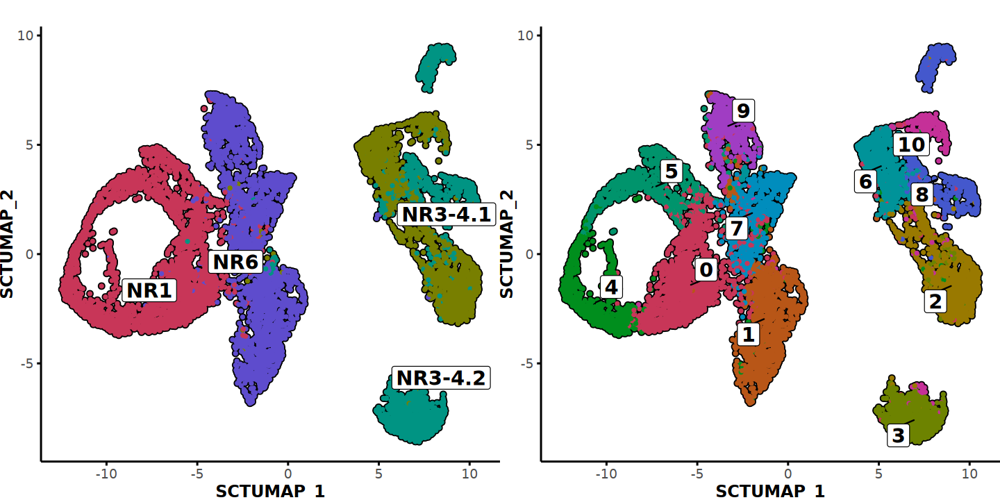

An object of class Seurat 
35316 features across 10665 samples within 3 assays 
Active assay: SCT (8328 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: Spatial, RNA
 14 dimensional reductions calculated: pca, integrated.rpca, umap, integrated.cca, RNA_PCA, SCT_PCA, RNA_UMAP, harmony, harmony_umap, harmonysct, harmonysct_umap, cca_umap, SCT_UMAP, integrated_UMAP
 4 spatial fields of view present: NR1 NR3.4.1 NR3.4.2 NR6

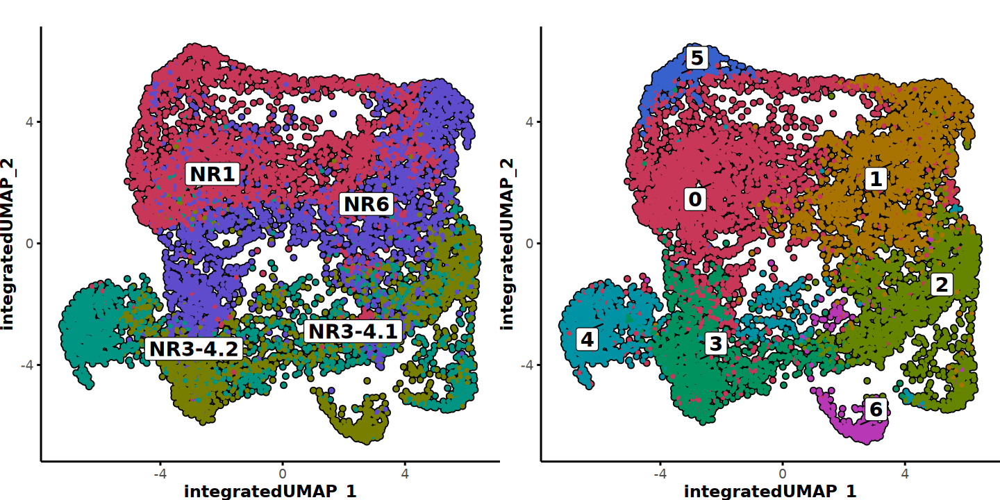

In [22]:
run_visualize_umaps(seur_obj)

In [23]:
seur_obj = select_assay(seur_obj,"harmonysct")

Warning message:
“Overwriting miscellanous data for cluster.choose”
Warning message:
“Overwriting miscellanous data for reduction.choose”
Warning message:
“Overwriting miscellanous data for embedding.choose”
Warning message:
“Overwriting miscellanous data for assay.choose”


In [24]:
seur_obj = run_presto_compartment_markers(seur_obj)
seur_obj = run_subclustering_presto(seur_obj,dims.choose = 1:10)

[1] "0"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3220
Number of edges: 108967

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8677
Number of communities: 3
Elapsed time: 0 seconds
[1] "2"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1826
Number of edges: 61957

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8827
Number of communities: 3
Elapsed time: 0 seconds


Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x2umap_’ instead”
Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x2umap_’ instead”


[1] "1"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2273
Number of edges: 73301

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8716
Number of communities: 3
Elapsed time: 0 seconds


Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x1umap_’ instead”
Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x1umap_’ instead”


[1] "5"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 424
Number of edges: 13344

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8540
Number of communities: 3
Elapsed time: 0 seconds


Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x5umap_’ instead”
Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x5umap_’ instead”


[1] "3"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1455
Number of edges: 47931

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8814
Number of communities: 3
Elapsed time: 0 seconds


Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x3umap_’ instead”
Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x3umap_’ instead”


[1] "4"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1141
Number of edges: 40460

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8391
Number of communities: 2
Elapsed time: 0 seconds


Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x4umap_’ instead”
Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x4umap_’ instead”


[1] "6"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 326
Number of edges: 10009

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8611
Number of communities: 3
Elapsed time: 0 seconds


Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x6umap_’ instead”
Warning message:
“Key ‘harmonysctumapopt_’ taken, using ‘x6umap_’ instead”


In [25]:
tam.genes = "SLC16A10

DMXL2

SLC11A1

FMNL2

ABCA1

KCNMA1

ERRFI1

CTSB

TYMP

PLA2G7

SPP1

NPL

CTSL

PARP14

IFI44L

FTL

TFRC

RALA

EPSTI1

PMP22

APOE

PLAU

ABCG1

GPNMB

RNASE1

IL2RA

CD80

XAF1

GNB4

HIF1A-AS3

IFI27

ATP6V0A1

IFI30

SIGLEC1

STAT1

WIPI1

STEAP1B

ARL4C

SPTAN1

CABLES1

SGPL1

SNTB1

CTSD

SCO2

DRAM1

CLIP4

SOAT1

EEPD1

TMEM51

PARP9

SRGAP1

PSTPIP2

PALD1

AOAH

RGS1

HLA-DRB1

HERPUD1

ABCC4

HLA-DRA

CD74

AREG

HLA-DPA1

NR4A3

HLA-DPB1

CCDC26

ADAM28

HLA-DQA1

CD86

PID1

JAML

NHSL1

MS4A4E

HLA-DRB5

RTN1

INSR

PLA2G4A

PCNX2

USP53

HLA-DQB1

SGK1

IL1R2

GRASP

IL13RA1

AFF3

KLHL5

DAGLB

SKIL

AC104365.1

ST18

CD83

OTULINL

AC087286.2

NR4A2

SYAP1

B3GNT5

TRA2B

NR4A1

PHLPP1

OGFRL1"
tam.genes = unlist(strsplit(tam.genes,"\n"))[1:30]
tam.genes = setdiff(tam.genes,"")
library(GSEABase)
geneSets <- GeneSet(tam.genes, setName="TAMs")
library(AUCell)
cells_AUC <- AUCell_run(LayerData(seur_obj, assay="RNA",layer="counts"), geneSets)

Loading required package: annotate

Loading required package: XML


Attaching package: ‘XML’


The following object is masked from ‘package:patchwork’:

    free



Attaching package: ‘annotate’


The following object is masked from ‘package:BiocNeighbors’:

    findNeighbors


Loading required package: graph


Attaching package: ‘graph’


The following object is masked from ‘package:XML’:

    addNode


The following objects are masked from ‘package:igraph’:

    degree, edges, intersection


The following object is masked from ‘package:stringr’:

    boundary


The following object is masked from ‘package:plyr’:

    join



Attaching package: ‘AUCell’


The following object is masked from ‘package:tradeSeq’:

    plotGeneCount




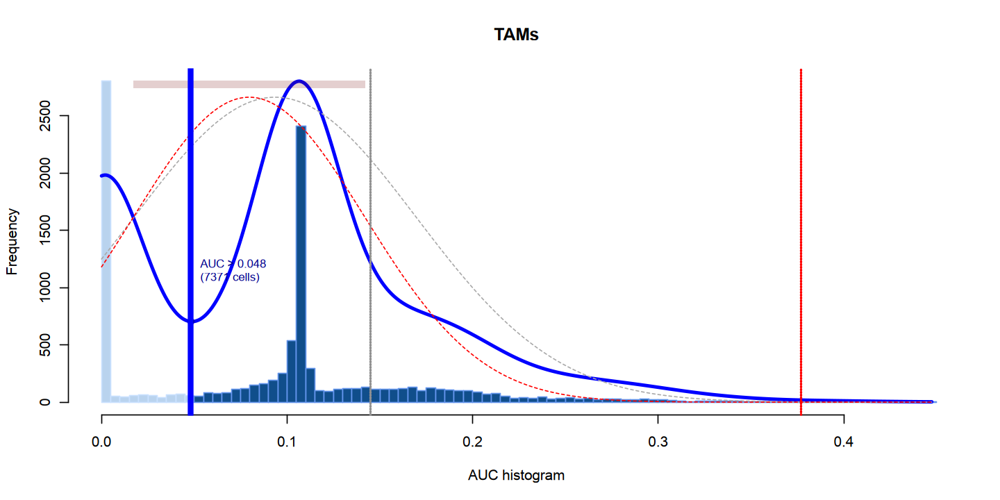

In [26]:
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, nCores=1, assign=TRUE)

In [27]:
seur_obj$TAM = unlist(assays(cells_AUC)[[1]])

In [28]:
uro.genes = "KRT19
LINC00511
MECOM
BAIAP2L1
PATJ
KLF5
CCSER1
EZR
MAST4
ITGA6
EFNA5
FAM160A1
ELF3
PARD3
GRHL2
SEPTIN9
KIAA1217
MAP7
PTPRK
AC013652.1
ANXA2
TMPRSS4
PPARG
SCHLAP1
NEDD4L
SAMD12
PTK2
EGFR
ANK3
KRT17"
uro.genes = unlist(strsplit(uro.genes,"\n"))[1:30]
uro.genes = setdiff(uro.genes,"")
library(GSEABase)
geneSets <- GeneSet(uro.genes, setName="Urothelial_sc")
library(AUCell)
cells_AUC <- AUCell_run(LayerData(seur_obj, assay="RNA",layer="counts"), geneSets)

In [29]:
seur_obj$Urothelial_sc = unlist(assays(cells_AUC)[[1]])

In [30]:
seur_obj$TamUroSig = apply(cbind(seur_obj@meta.data[,c("TAM","Urothelial_sc")]), 1, function(x){
    sum(x)/2
})

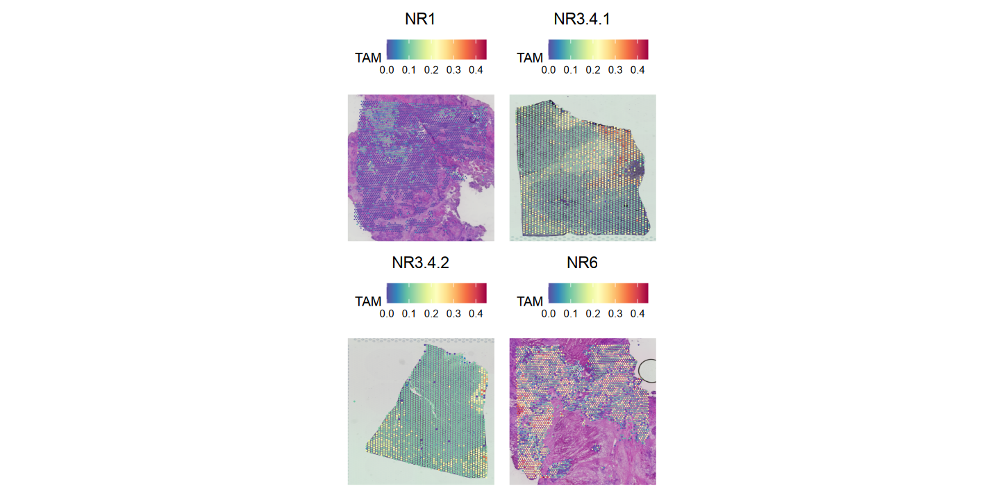

In [31]:
SpatialFeaturePlot(seur_obj, features ="TAM",ncol=2)

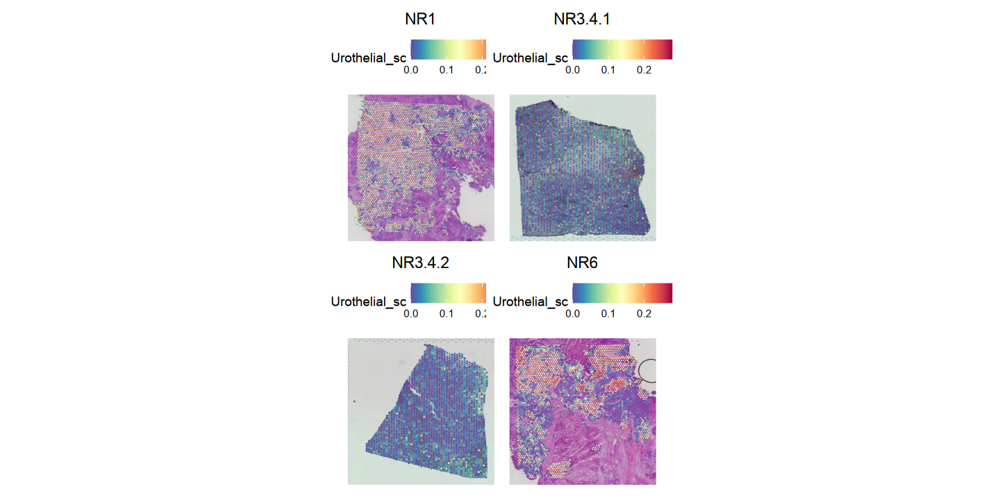

In [32]:
SpatialFeaturePlot(seur_obj, features ="Urothelial_sc",ncol=2)

In [33]:
seur_obj$TamUroSigScale = scale(seur_obj$TamUroSig)

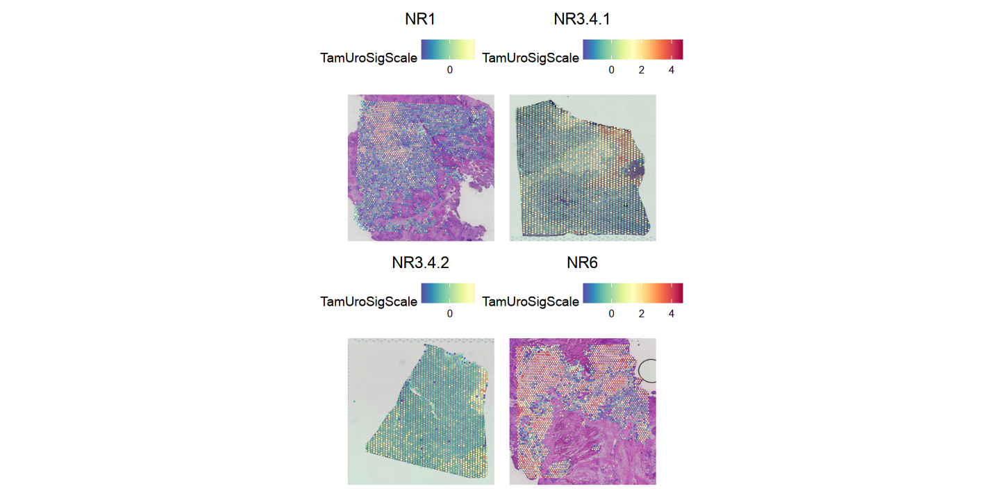

In [34]:
SpatialFeaturePlot(seur_obj, features ="TamUroSigScale",ncol=2)

In [35]:
seur_obj$TamUroSigScalePerSample = unlist(lapply(split(seur_obj$TamUroSig , as.factor(seur_obj$Sample)),scale),use.names=F)

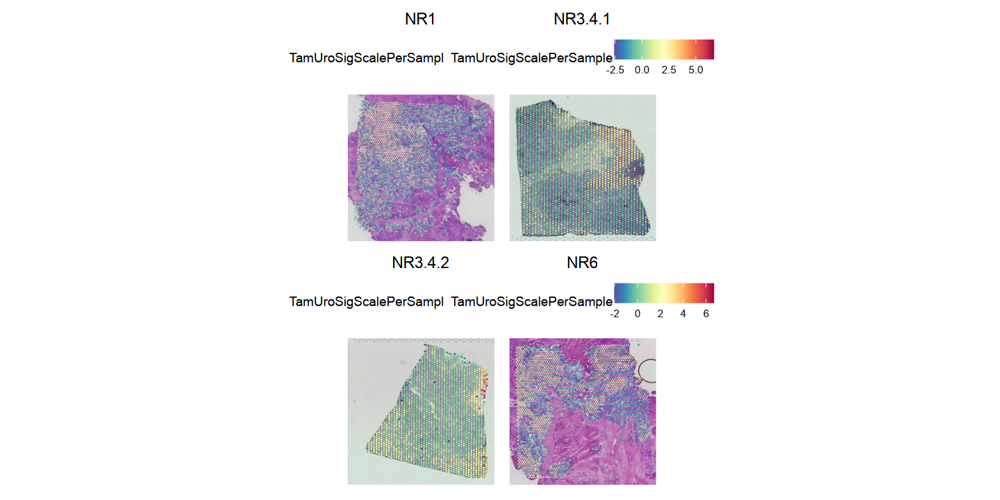

In [36]:
SpatialFeaturePlot(seur_obj, features ="TamUroSigScalePerSample",ncol=2)

In [37]:
geneSets <- GeneSet(uro.genes, setName="TAM")
cells_AUC <- AUCell_run(LayerData(seur_obj, assay="RNA",layer="counts")[,seur_obj$Sample == "NR3-4.1"], geneSets)
seur_obj$Urothelial_sc = unlist(assays(cells_AUC)[[1]])
geneSets <- GeneSet(uro.genes, setName="Urothelial_sc")
cells_AUC <- AUCell_run(LayerData(seur_obj, assay="RNA",layer="counts")[,seur_obj$Sample == "NR3-4.1"], geneSets)


In [38]:
table(seur_obj$Sample, seur_obj$harmonysct_clusters)

         
             0    1    2    3    4    5    6
  NR1     2046  108   34  818  413   26    0
  NR3-4.1  182  831  779   44   60  258   60
  NR3-4.2  146  540  955   32   32   33  235
  NR6     1199  425   29  855  463   61    1

In [39]:
rownames(seur_obj)[grepl("KRT",rownames(seur_obj))]

[1] "KRTCAP2" "KRT8"    "KRT18"   "KRT10"

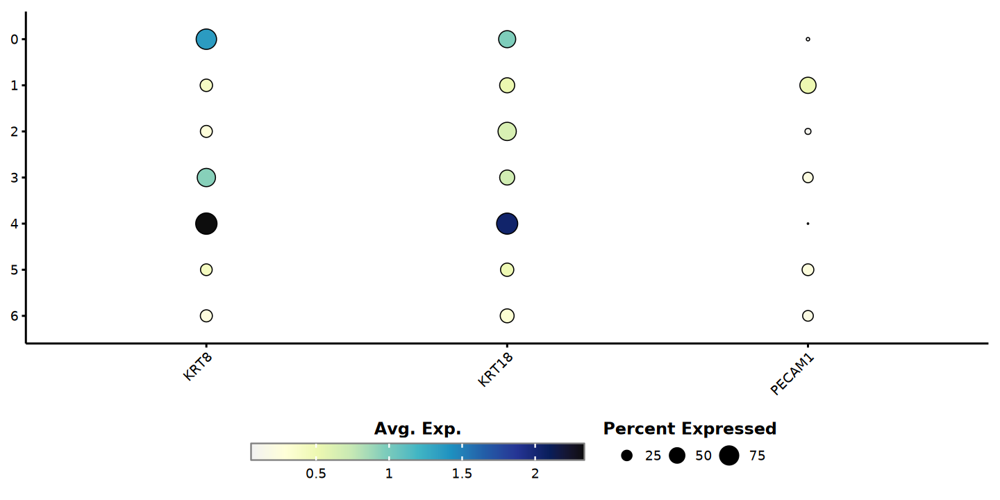

In [40]:
do_DotPlot(seur_obj,group.by="harmonysct_clusters",features=c("KRT5","KRT8","KRT18","CD163","CD3E","CD8","CD8A","PTPRC","PECAM1","KIT","BLK2","MS4A1"))

In [53]:
lapply(Misc(seur_obj,"CompartmentGeneMarkers"),head,10)

,feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3936,GATA3,0,1.708356,1.2236711,21265671,0.8392229,0,0,88.21718,33.38973
5249,KLF5,0,1.625704,1.1321196,19621526,0.7743388,0,0,77.07809,30.64016
5281,ARGLU1,0,1.920026,1.1147909,20844336,0.8225955,0,0,94.03862,67.92160
6466,MLLT6,0,1.794950,1.1130632,20661344,0.8153739,0,0,90.73608,57.78342
7747,LAMA5,0,1.649932,1.0881617,21472582,0.8473884,0,0,91.77162,45.50197
7404,CYTH2,0,1.600131,0.9729049,20993406,0.8284783,0,0,91.46376,60.84320
3553,MROH1,0,1.452463,0.9484890,20451060,0.8070753,0,0,86.50994,46.55950
3565,KIFC2,0,1.208604,0.9297794,20223376,0.7980901,0,0,75.93059,28.22899
5,AGRN,0,1.536324,0.8705501,20294304,0.8008892,0,0,90.90400,59.54597


In [42]:
my.matches = c("EPI","MYEL","EPI","STR","EPI","MYEL","MYEL")

In [43]:
names(my.matches) = seq(0, (length(my.matches) - 1))

In [44]:
my.matches2 = my.matches[match(seur_obj$harmonysct_clusters, names(my.matches))]

In [45]:
names(my.matches2) = NULL

In [46]:
my.matches2[grepl("6_0|6_1", seur_obj$SubCluster)] = "TAM"

In [47]:
seur_obj$Designation = my.matches2

In [48]:
table(seur_obj$Sample,seur_obj$Designation)

         
           EPI MYEL  STR  TAM
  NR1     2493  134  818    0
  NR3-4.1 1020  908   39  247
  NR3-4.2 1133  803   32    5
  NR6     1691  483  855    4

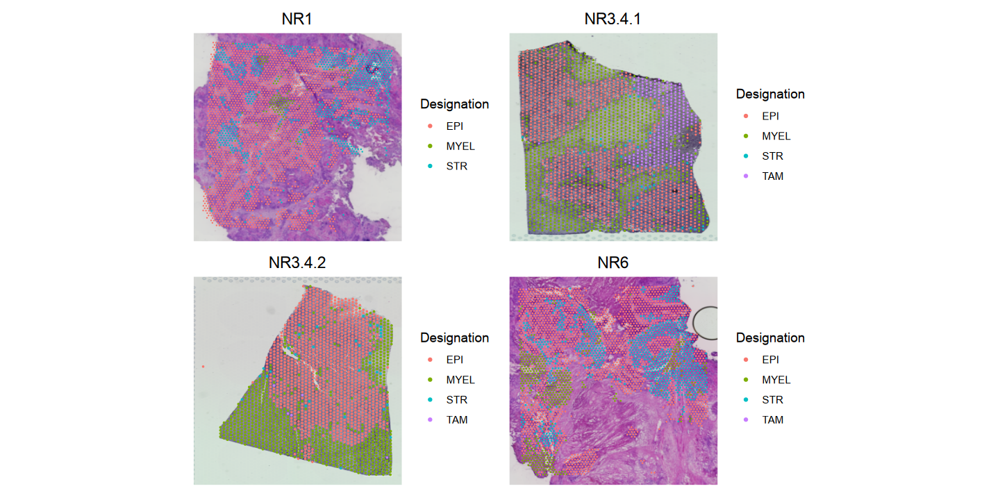

In [49]:
SpatialDimPlot(seur_obj, group.by="Designation",ncol=2)

In [50]:
table(seur_obj$Designation)


 EPI MYEL  STR  TAM 
6337 2328 1744  256 

In [54]:
library(VoltRon)

In [52]:
setwd("/data/work/Projects/STU/230726_DiCarvalho_Cytassist/240621/")

In [55]:
seur_obj = readRDS("20240621_object.RDS")

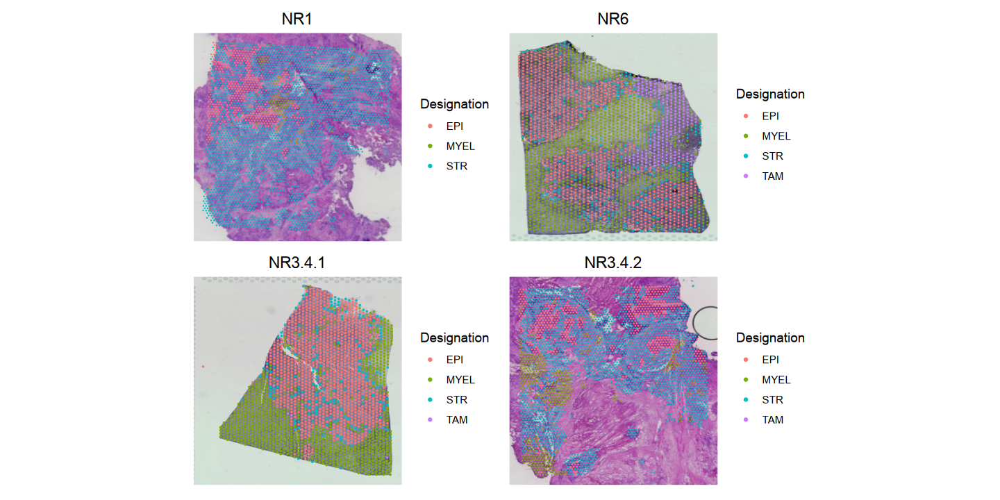

In [56]:
SpatialDimPlot(seur_obj, group.by="Designation",ncol=2)

In [57]:
Misc(seur_obj,"cluster.choose")

[1] "harmonysct_clusters"

In [58]:
lapply(Misc(seur_obj,"CompartmentGeneMarkers"),head,20)

,feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3936,GATA3,0,1.708356,1.2236711,21265671,0.8392229,0,0,88.21718,33.38973
5249,KLF5,0,1.625704,1.1321196,19621526,0.7743388,0,0,77.07809,30.64016
5281,ARGLU1,0,1.920026,1.1147909,20844336,0.8225955,0,0,94.03862,67.92160
6466,MLLT6,0,1.794950,1.1130632,20661344,0.8153739,0,0,90.73608,57.78342
7747,LAMA5,0,1.649932,1.0881617,21472582,0.8473884,0,0,91.77162,45.50197
7404,CYTH2,0,1.600131,0.9729049,20993406,0.8284783,0,0,91.46376,60.84320
3553,MROH1,0,1.452463,0.9484890,20451060,0.8070753,0,0,86.50994,46.55950
3565,KIFC2,0,1.208604,0.9297794,20223376,0.7980901,0,0,75.93059,28.22899
5,AGRN,0,1.536324,0.8705501,20294304,0.8008892,0,0,90.90400,59.54597


In [59]:
options(repr.plot.height=16, repr.plot.width=16)


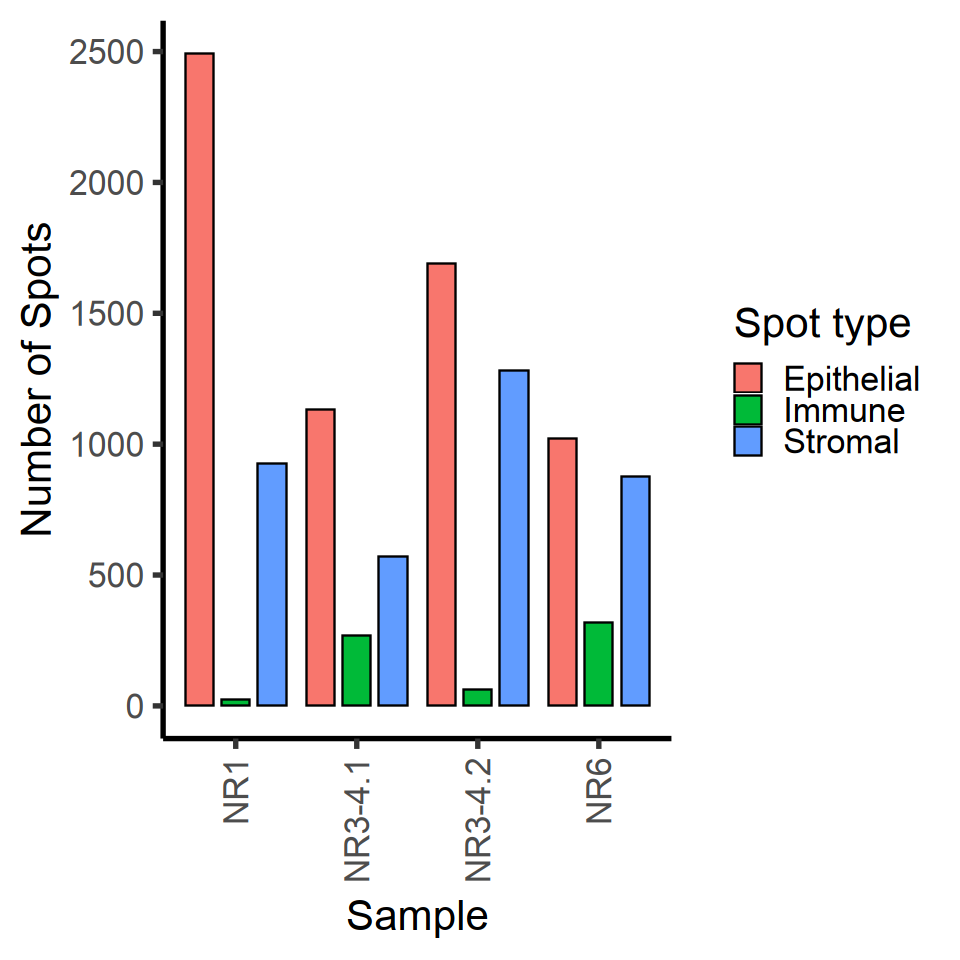

    NR1 NR3-4.1 NR3-4.2     NR6 
   3445    1973    3033    2214 


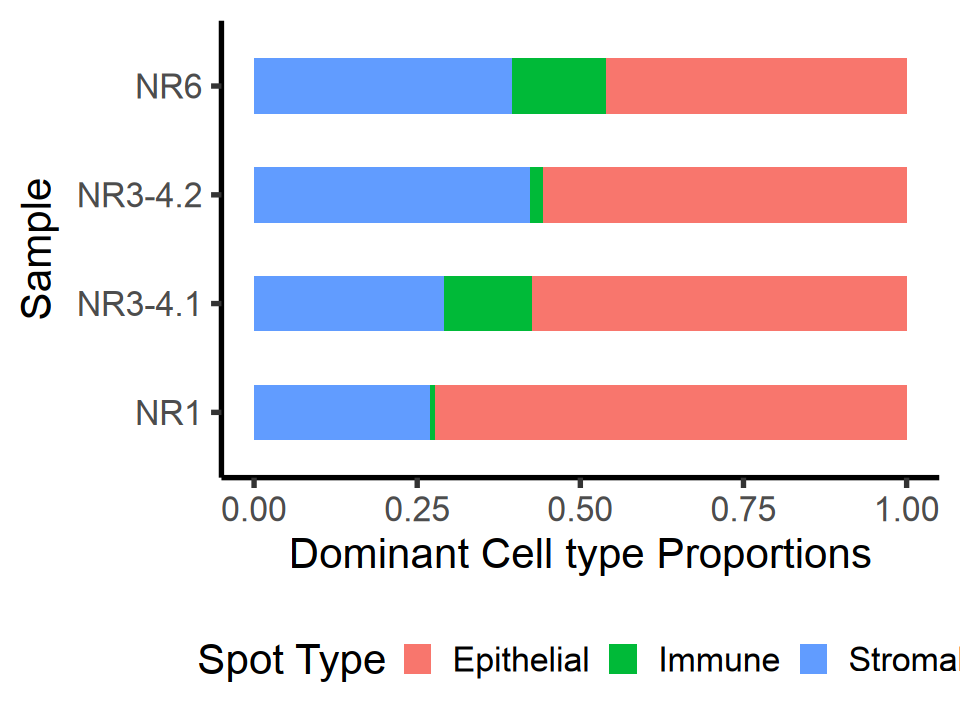

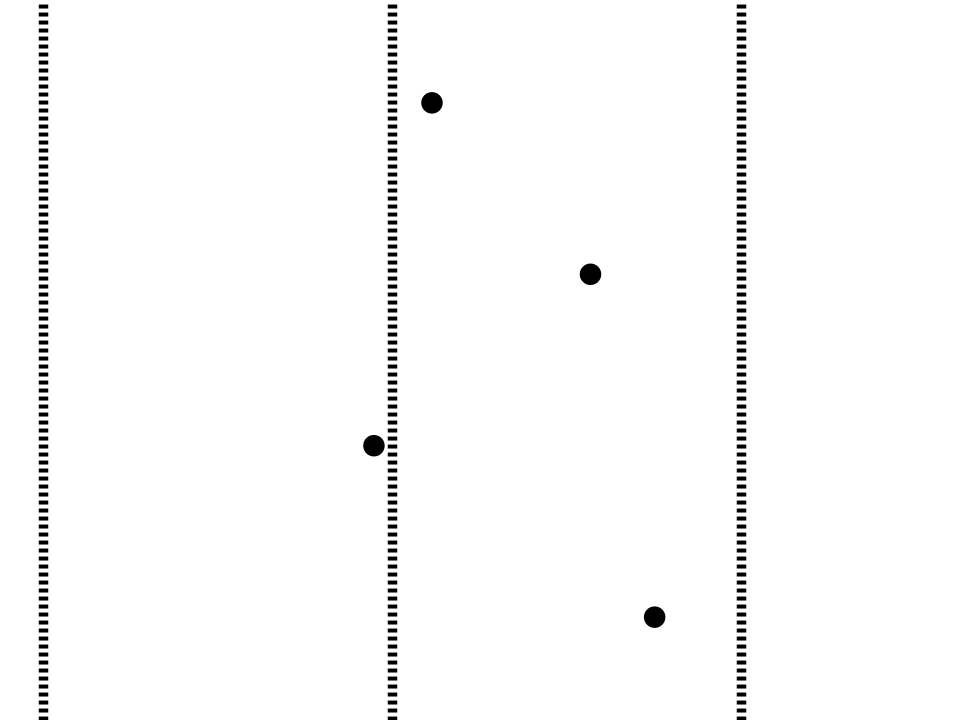

In [60]:
#Load object
seur_obj = readRDS("20240621_object.RDS")
#Cluster matching
my.matches = c("EPI","STR","EPI","STR","EPI","IMM","IMM")
names(my.matches) = seq(1,length(my.matches)) - 1
my.matches = my.matches[match(unlist(seur_obj[[Misc(seur_obj,"cluster.choose")]]),names(my.matches))]
names(my.matches) = NULL
seur_obj$TempDes = my.matches
#seur_obj$TempDes[seur_obj$TAM > quantile(seur_obj$TAM,0.97)] = "TAM"
names(seur_obj@images) = c("NR1","NR3.1","NR3.2","NR6")
ggplot.df = reshape2::melt(table(seur_obj$TempDes,seur_obj$Sample))
ggplot.df$Var1  = gsub("EPI","Epithelial",ggplot.df$Var1)
ggplot.df$Var1  = gsub("IMM","Immune",ggplot.df$Var1)
ggplot.df$Var1  = gsub("STR","Stromal",ggplot.df$Var1)
ggplot.df$Var1 = gsub("TAM","Immune",ggplot.df$Var1)
#Vertical bars (original)
options(repr.plot.height=8,repr.plot.width=8)
p = ggbarplot(ggplot.df, x = "Var2",y="value",fill="Var1",position = position_dodge(0.9)) + xlab("Sample") + ylab("Number of Spots") +
theme_classic(base_size=25) + guides(fill=guide_legend(title="Spot type")) + scale_x_discrete(guide = guide_axis(angle = 90))
plot(p)
ggsave("Carvalho_barplot.svg",p,units="in",dpi=300,width=8,height=8)
system("rclone copy --progress Carvalho_barplot.svg Drive:Carvalho_SVGs")
#HOrizontal (New)
options(repr.plot.width=8,repr.plot.height=6)
p = ggplot(ggplot.df, aes(fill=Var1, y=Var2, x=value,width=0.5)) + 
    geom_bar(position="fill", stat="identity",width=0.5) + xlab("Dominant Cell type Proportions") + ylab("Sample") +
theme_classic(base_size=25) + guides(fill=guide_legend(title="Spot Type"))  + theme(legend.position="bottom")
p
ggsave("Barplot_horizontal.svg", p, units="in",height=6,width=8, dpi=300)
system("rclone copy --progress Barplot_horizontal.svg Drive:Carvalho_SVGs")
#Make the total cells DF
total.cells =  unlist(lapply(split(ggplot.df, ggplot.df$Var2), function(x) sum(x$value)))
print(total.cells)
#Log2, fix names, make into DF
total.cellslog2 = log2(total.cells)
total.cellslog2 = reshape2::melt(total.cellslog2)
total.cellslog2$Sample = rownames(total.cellslog2)
colnames(total.cellslog2)[1] = "Log2Spots"
#Generate plot with points, empty x and y axes, add horizontal lines
p = ggplot(total.cellslog2, aes(x=Log2Spots,y=Sample)) + geom_point(size=5) +
theme_void(base_size=25) + xlim(c(10,12.5)) + 
theme(axis.title.x=element_blank(),
        axis.text.x=element_blank(),
        axis.ticks.x=element_blank()) +
theme(axis.title.y=element_blank(),
        axis.text.y=element_blank(),
        axis.ticks.y=element_blank()) +
geom_vline(xintercept = 10,linetype="dashed",linewidth=2) +
geom_vline(xintercept = 11,linetype="dashed",linewidth=2) + 
geom_vline(xintercept = 12,linetype="dashed",linewidth=2)

plot(p)

ggsave("Spotnumber_plot.svg", p, units="in",height=6,width=8, dpi=300)
system("rclone copy --progress Spotnumber_plot.svg Drive:Carvalho_SVGs")

In [61]:
ggsave("Spotnumber_plot.svg", p, units="in",height=6,width=8, dpi=300)
system("rclone copy --progress Spotnumber_plot.svg Drive:Carvalho_SVGs")

In [62]:
seur_obj$TempDes[seur_obj$TempDes == "TAM"] = "IMM"

In [63]:
table(seur_obj$TempDes)


 EPI  IMM  STR 
6338  674 3653 

In [64]:
Idents(seur_obj) = make.names(seur_obj$TempDes)

In [65]:
table(Idents(seur_obj))


 EPI  STR  IMM 
6338 3653  674 

In [66]:
seur_obj = run_presto_compartment_markers(seur_obj)
seur_obj = run_subclustering_presto(seur_obj,dims.choose = 1:10)

[1] "EPI"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 6338
Number of edges: 209408

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8966
Number of communities: 4
Elapsed time: 0 seconds
[1] "STR"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3653
Number of edges: 120741

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9060
Number of communities: 5
Elapsed time: 0 seconds
[1] "IMM"
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 674
Number of edges: 23006

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8930
Number of communities: 3
Elapsed time: 0 seconds


In [78]:
ggplot.df = as.data.frame.matrix(seur_obj@meta.data[,c("SubCluster","TAM")])

In [89]:
comparison.list = paste("IMM_2", setdiff(unique(seur_obj$SubCluster), "IMM_2"))

In [92]:
comparison.list = strsplit(comparison.list, " ")

In [123]:
sapply(seq(comparison.list), function(x) 0.5 + 0.03*x)

[1] 0.53 0.56 0.59 0.62 0.65 0.68 0.71 0.74 0.77 0.80 0.83

In [147]:
options(repr.plot.height=10, repr.plot.width=10)

p = VlnPlot(seur_obj,"TAM",group.by="SubCluster")  + ggtitle("") +
 scale_x_discrete(guide = guide_axis(angle = 90))


p = p + ylab("TAM Module Score") + theme_classic(base_size=25) + NoLegend()
p = p + stat_compare_means(label = "p.signif",comparisons = comparison.list,aes(label=..p.adj..),
                           bracket.size=0.3,
                           tip.length=0.01,
                           vjust=1,
                          label.y=sapply(seq(comparison.list), function(x) 0.44 + 0.02*x)) + ylim(0,0.65)

Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


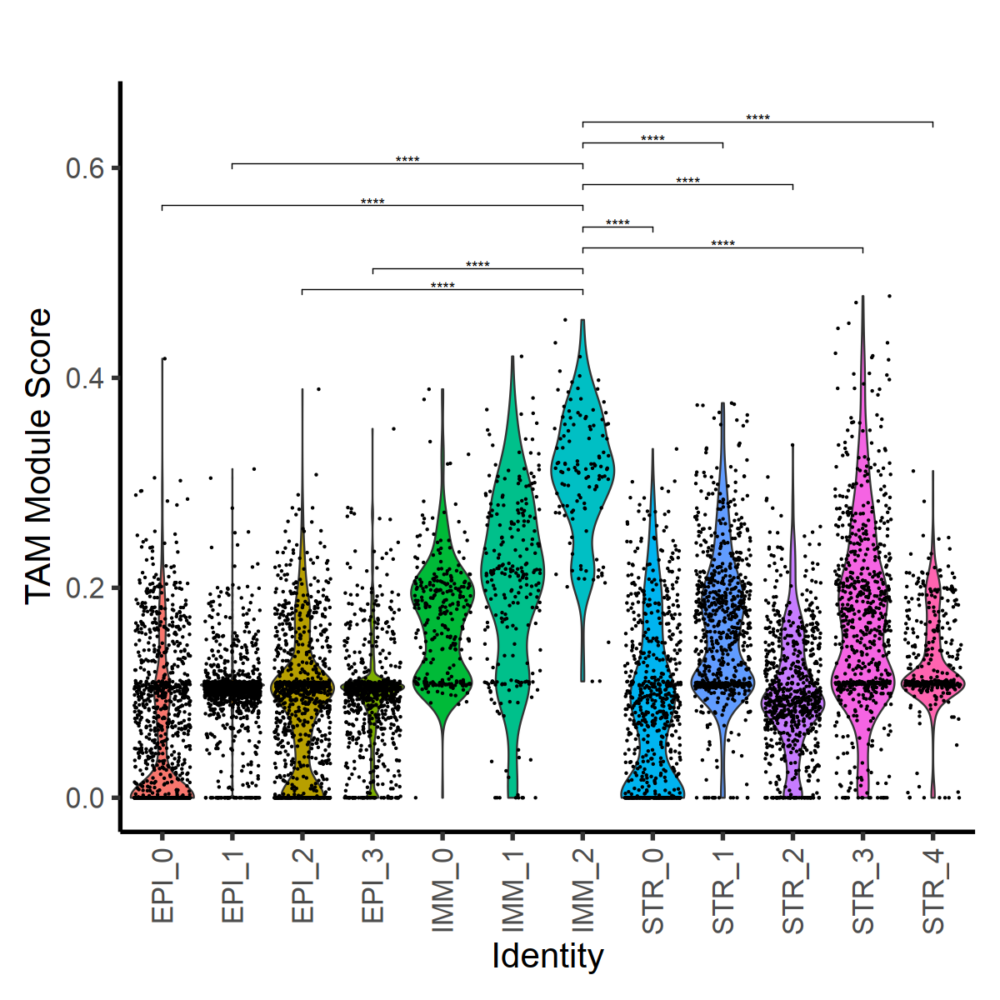

In [148]:
p

In [158]:
comparison.list = paste("IMM_2", setdiff(c("IMM_0","IMM_1","IMM_2"), "IMM_2"))
comparison.list = strsplit(comparison.list, " ")

In [169]:
options(repr.plot.height=10, repr.plot.width=10)

p = VlnPlot(seur_obj,"TAM",group.by="SubCluster")  + ggtitle("") +
 scale_x_discrete(guide = guide_axis(angle = 90))


p = p + ylab("TAM Module Score") + theme_classic(base_size=25) + NoLegend()
p = p + stat_compare_means(label = "p.signif",comparisons = comparison.list,aes(label=..p.adj..),
                           bracket.size=0.3,
                           tip.length=0.02,
                           vjust=1,
                          label.y=sapply(seq(comparison.list), function(x) 0.44 + 0.02*x)) + ylim(0,0.52)

Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


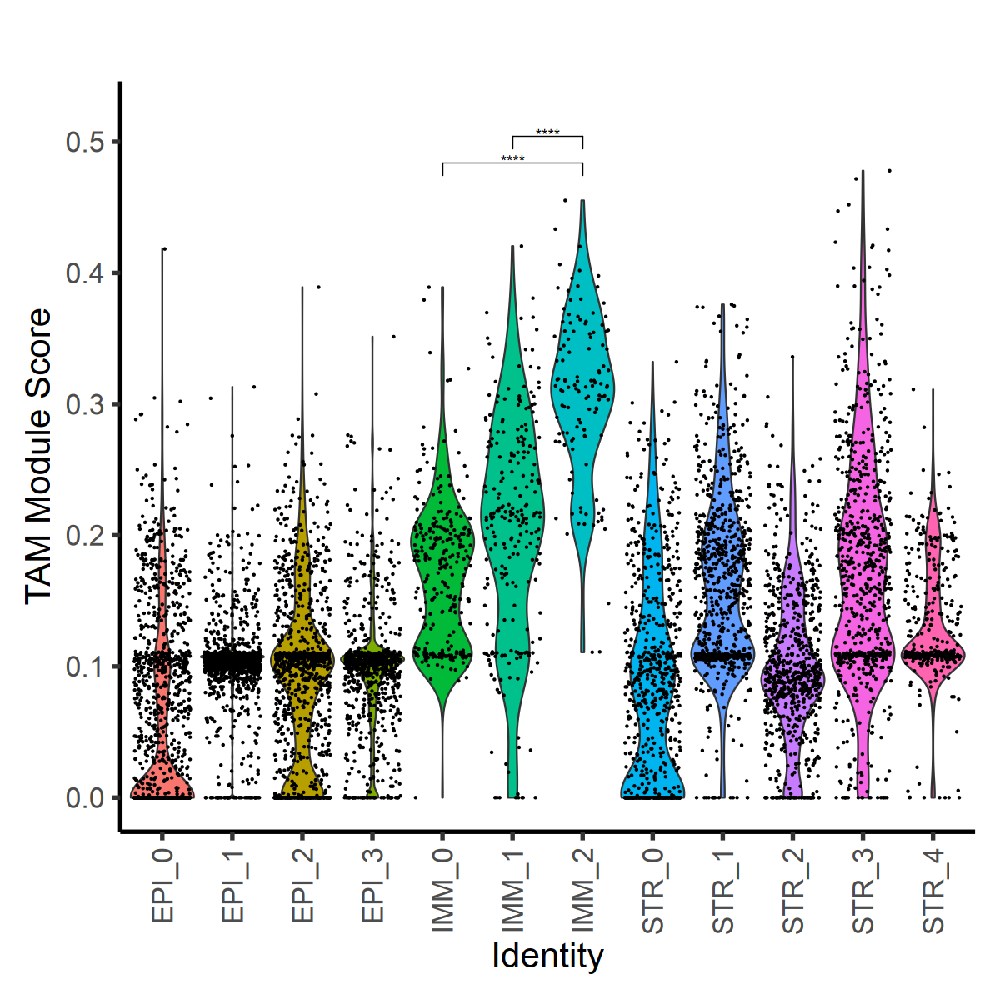

In [170]:
p

In [143]:
ggsave("250131_Carvalho_violin.svg",p,units="in",dpi=300,width=8,height=8)

In [144]:
system("rclone copy --progress Carvalho_violin.svg Drive:Carvalho_SVGs")

In [121]:
seur_obj$TempDes[seur_obj$SubCluster == "IMM_2"] = "TAM"

In [123]:
table(seur_obj$TempDes, seur_obj$Sample)

     
       NR1 NR3-4.1 NR3-4.2  NR6
  EPI 2493    1133    1691 1021
  IMM   26     258      58  203
  STR  926     553    1210  839
  TAM    0      29      74  151

In [129]:
p = SpatialDimPlot(seur_obj, group.by="TempDes",ncol=1,images = names(seur_obj@images)[1])  & coord_fixed()

Coordinate system already present. Adding new coordinate system, which will replace the existing one.


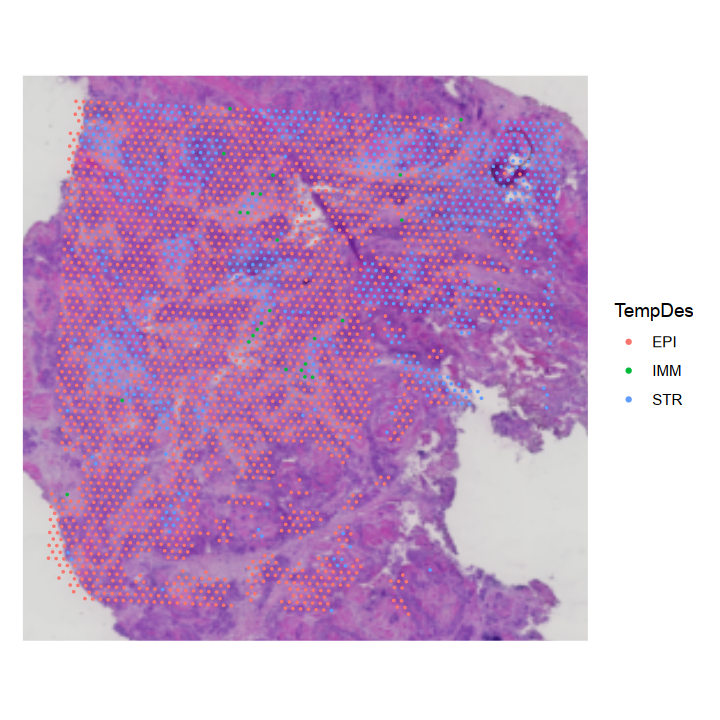

In [130]:
p

In [131]:
p = SpatialDimPlot(seur_obj, group.by="TempDes",ncol=1,images = names(seur_obj@images)[3])  & coord_fixed()

Coordinate system already present. Adding new coordinate system, which will replace the existing one.


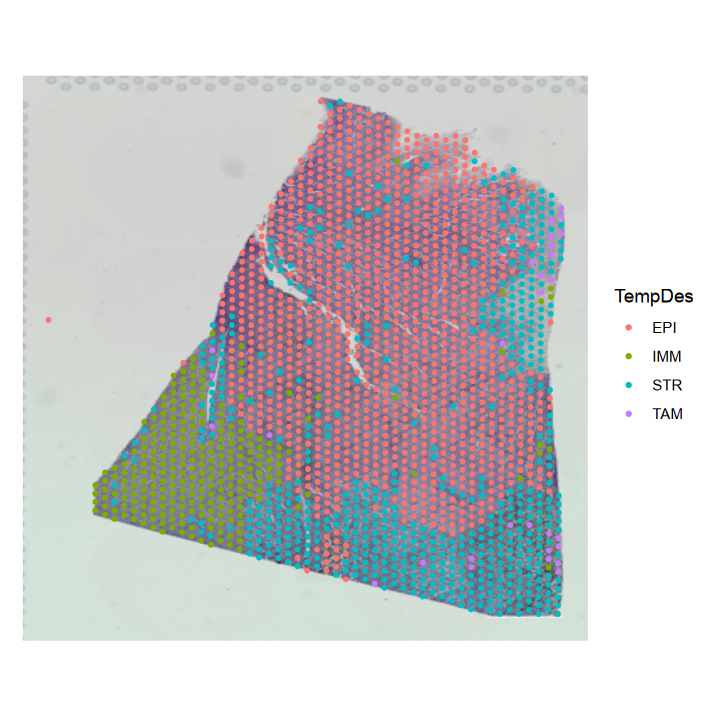

In [132]:
p

In [ ]:
p = SpatialDimPlot(seur_obj, group.by="TempDes",ncol=1,images = names(seur_obj@images)[3])  & coord_fixed()

In [133]:
p = SpatialDimPlot(seur_obj, group.by="TempDes",ncol=1,images = names(seur_obj@images)[4])  & coord_fixed()

Coordinate system already present. Adding new coordinate system, which will replace the existing one.


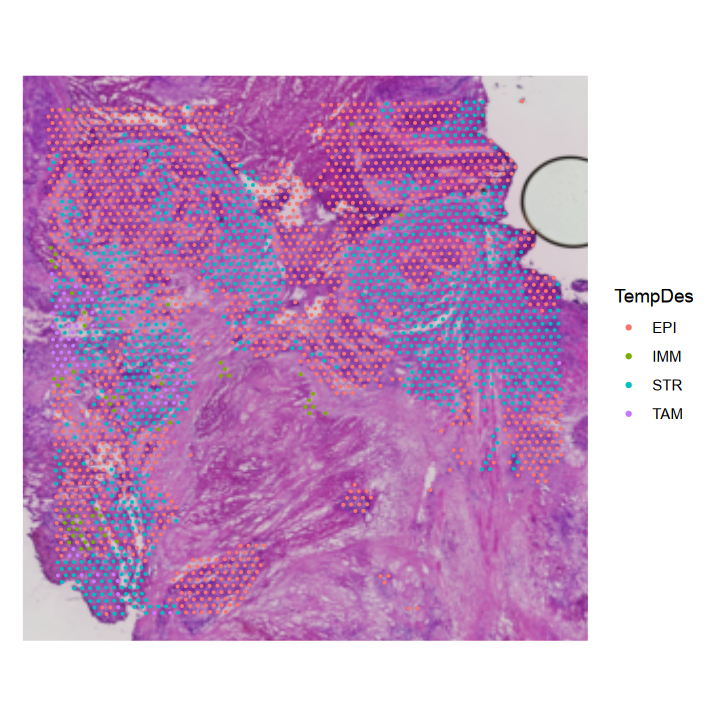

In [134]:
p

In [126]:
p = SpatialDimPlot(seur_obj, group.by="TempDes",ncol=1,images = names(seur_obj@images)[2])  & coord_fixed()

Coordinate system already present. Adding new coordinate system, which will replace the existing one.


In [127]:
ggsave("Carvalho_SpatialDim.svg",p,units="in",dpi=300,width=8,height=8)

In [128]:
system("rclone copy --progress Carvalho_SpatialDim.svg Drive:Carvalho_SVGs")

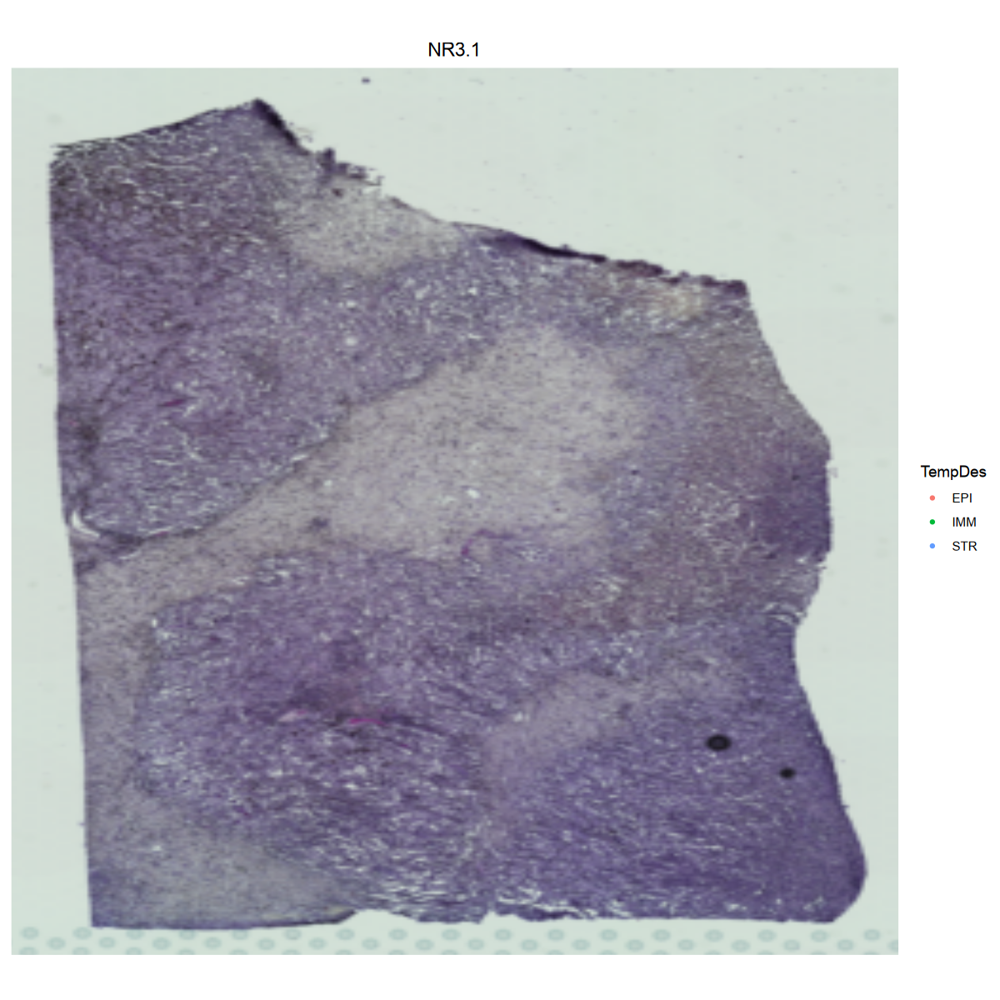

In [173]:
SpatialDimPlot(seur_obj, group.by="TempDes",ncol=1,combine=F,pt.size.factor = 0)[[2]]

Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.


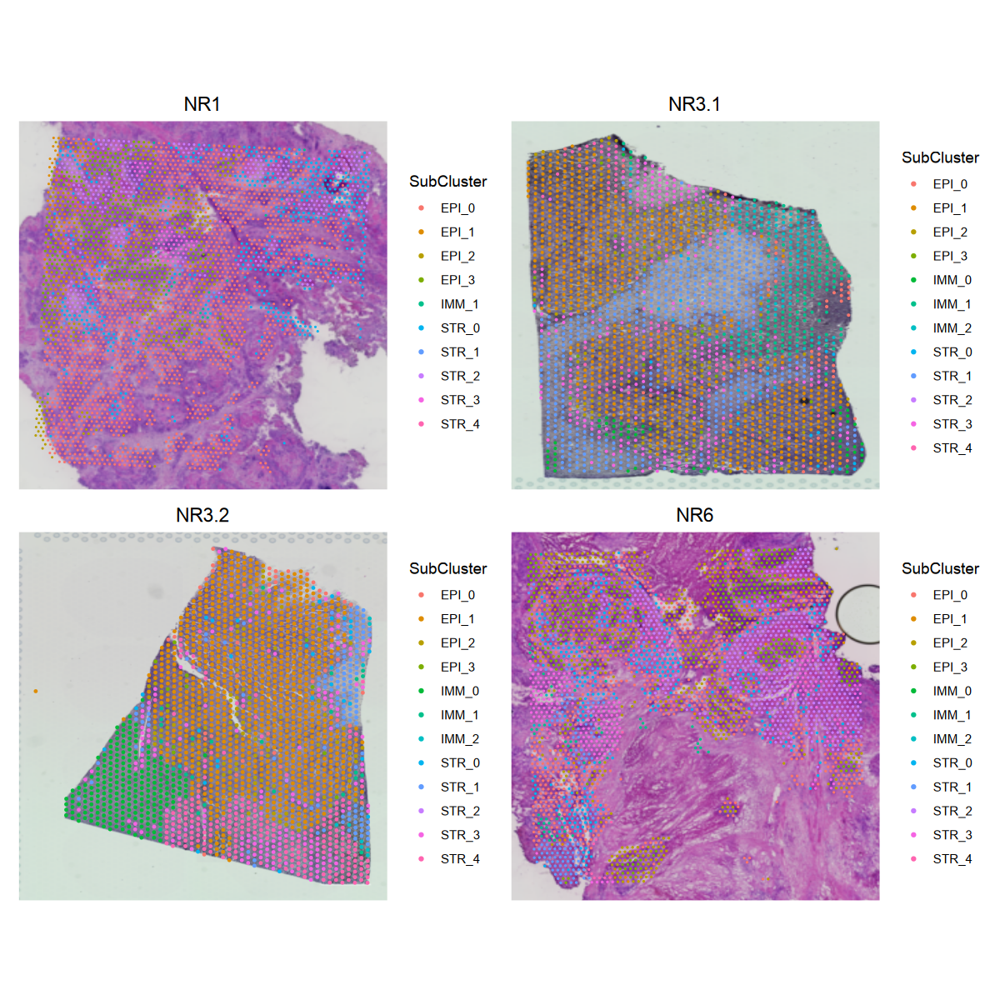

In [174]:
SpatialDimPlot(seur_obj, group.by="SubCluster",ncol=2)  & coord_fixed()

Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.


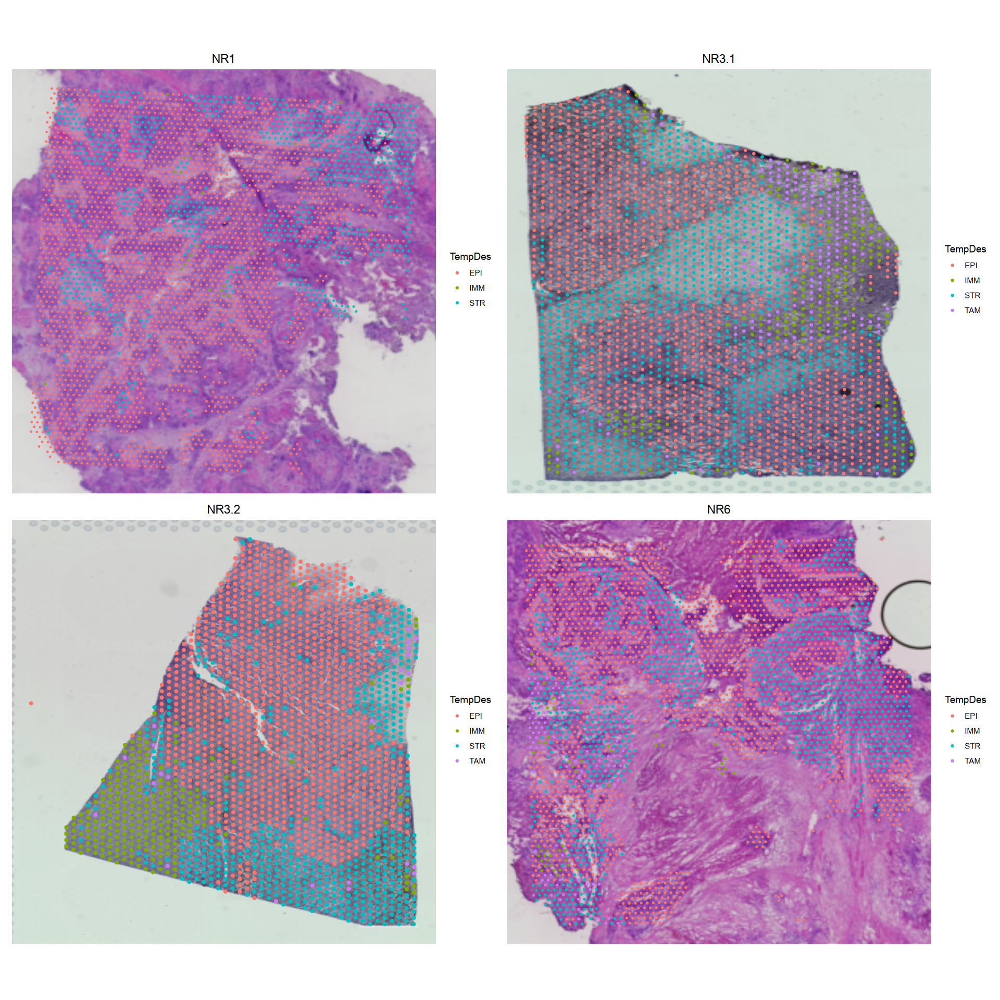

In [18]:
SpatialDimPlot(seur_obj, group.by="TempDes",ncol=2)  & coord_fixed()

Loading required package: annotate

Loading required package: AnnotationDbi


Attaching package: ‘AnnotationDbi’


The following object is masked from ‘package:MASS’:

    select


The following object is masked from ‘package:dplyr’:

    select


Loading required package: XML


Attaching package: ‘XML’


The following object is masked from ‘package:patchwork’:

    free



Attaching package: ‘annotate’


The following object is masked from ‘package:BiocNeighbors’:

    findNeighbors


Loading required package: graph


Attaching package: ‘graph’


The following object is masked from ‘package:XML’:

    addNode


The following objects are masked from ‘package:igraph’:

    degree, edges, intersection


The following object is masked from ‘package:stringr’:

    boundary


The following object is masked from ‘package:plyr’:

    join



Attaching package: ‘AUCell’


The following object is masked from ‘package:tradeSeq’:

    plotGeneCount




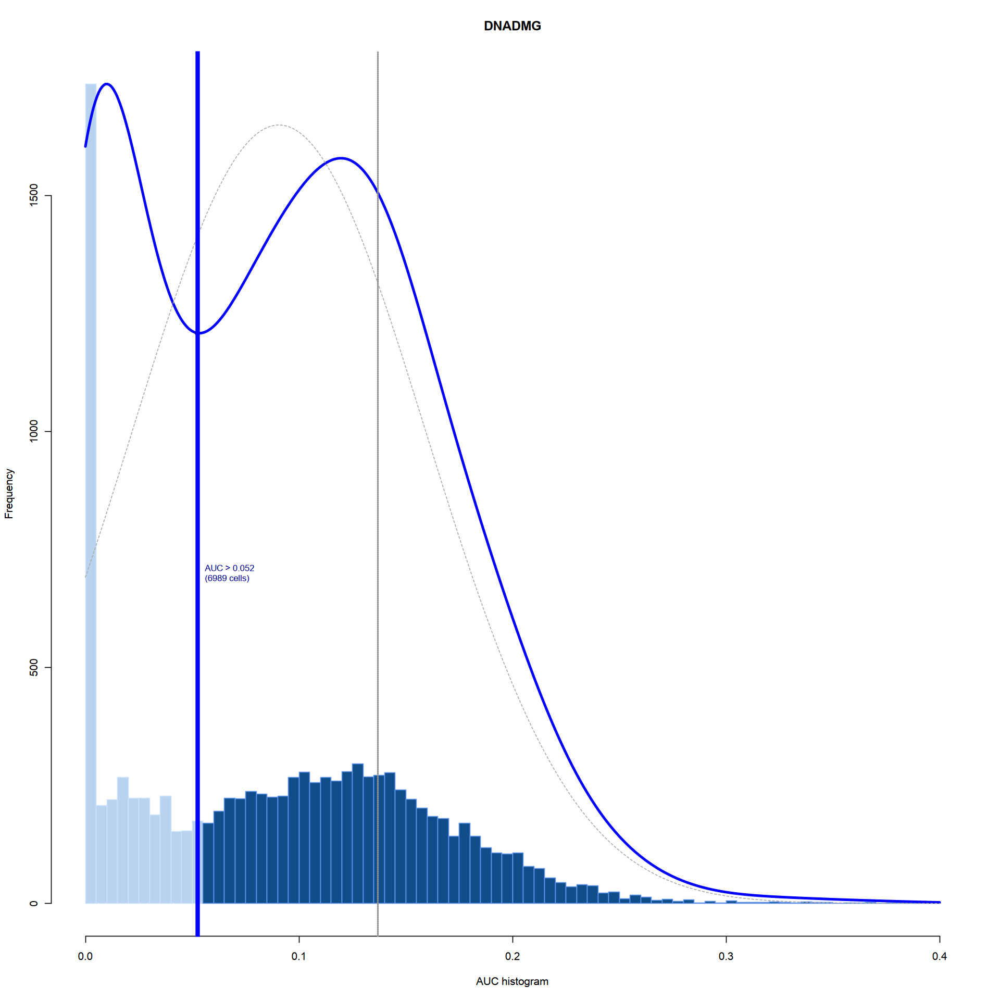

In [19]:
dmg.genes = "ALDH3A1, BST2, CA2, CCNA1, CD59, CXCL1, CXCL10, DAZ1, DCN, FLJ20035, FLJ38348, G1P2, G1P3, GALC, HERC6, HLA-B, HLA-G, HSD17B1, IFI27, IFI35, IFI44, IFI44L, IFIT1, IFIT3, IFITM1, IGF2, IRF7, LAMP3, LGALS3BP, LY6E, MCL1, MX1, MX2, OAS1, OAS3, OASL, PLSCR1, RAP2C, ROBO1, SERPINB2, SH3YL1, SLC6A15, STAT1, THBS1, TIMP3, TNC, TRIM14, USP18, ZNF273"
dmg.genes = unlist(strsplit(dmg.genes,", "))
dmg.genes = setdiff(dmg.genes,"")
library(GSEABase)
geneSets <- GeneSet(dmg.genes, setName="DNADMG")
library(AUCell)
cells_AUC <- AUCell_run(LayerData(seur_obj, assay="RNA",layer="counts"), geneSets)
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, nCores=1, assign=TRUE)

In [20]:
seur_obj$DMGResponse = unlist(assays(cells_AUC)[[1]])

In [99]:
unlink("Output",recursive=T)

In [100]:
dir.create("Output")

In [101]:
DefaultAssay(seur_obj) = "RNA"

In [102]:
paste(intersect(dmg.genes, rownames(LayerData(seur_obj,assay="RNA",layer="counts"))),collapse=", ")

[1] "BST2, CD59, DCN, GALC, HERC6, IFI27, IFI35, IFI44, IRF7, LGALS3BP, LY6E, MCL1, MX1, MX2, OAS1, OAS3, PLSCR1, RAP2C, ROBO1, SH3YL1, STAT1, THBS1, TIMP3, TNC, TRIM14"

In [103]:
seur_obj = run_pas(seur_obj, assay="RNA",species="human",pathways = list(DMGResistance = dmg.genes,TAM = tam.genes,URO = uro.genes))

New names:
• `` -> `...1`
Rows: 13848 Columns: 10666
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: ","
chr     (1): ...1
dbl (10665): NR1_AACACCTACTATCGAA-1, NR1_AACACTTGGCAAGGAA-1, NR1_AACAGGCCAAC...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [104]:
LayerData(seur_obj,assay="Pathways",layer="data") = LayerData(seur_obj,assay="Pathways",layer="scale.data")

In [105]:
DefaultAssay(seur_obj) = "Pathways"

Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.


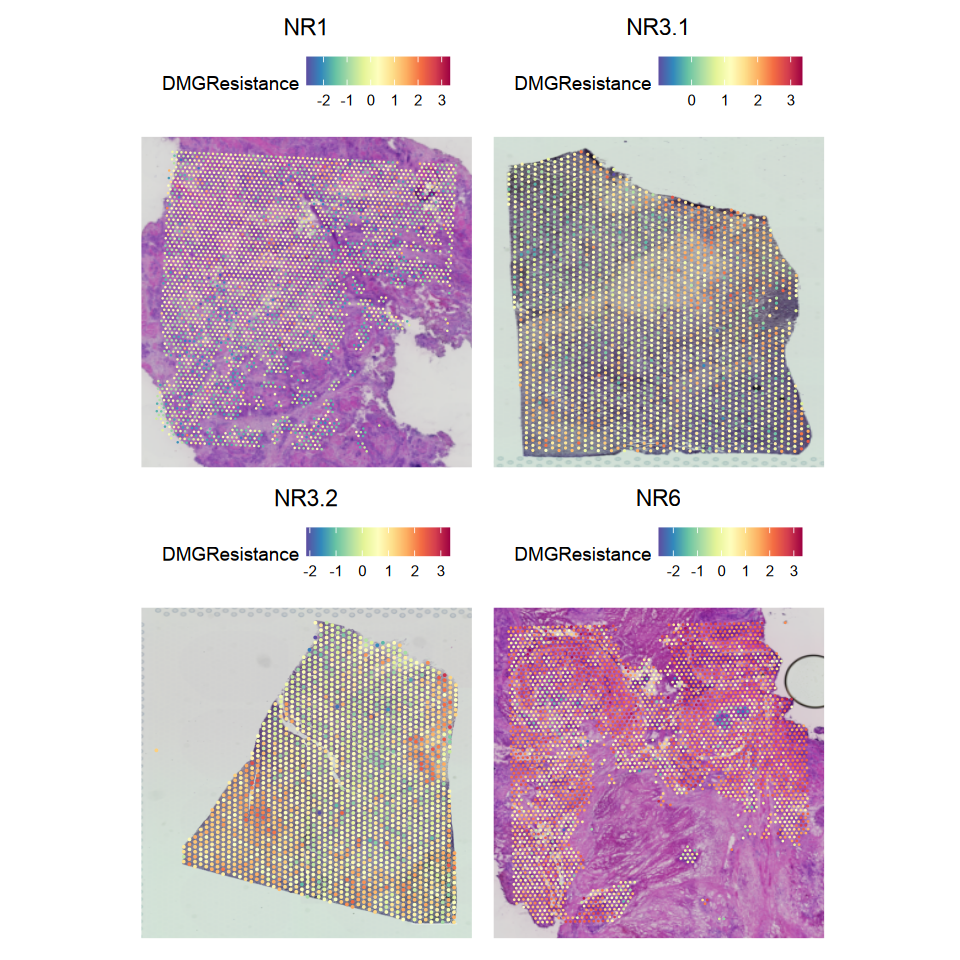

In [106]:
SpatialFeaturePlot(seur_obj, features ="DMGResistance",ncol=2)  & coord_fixed()

Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.


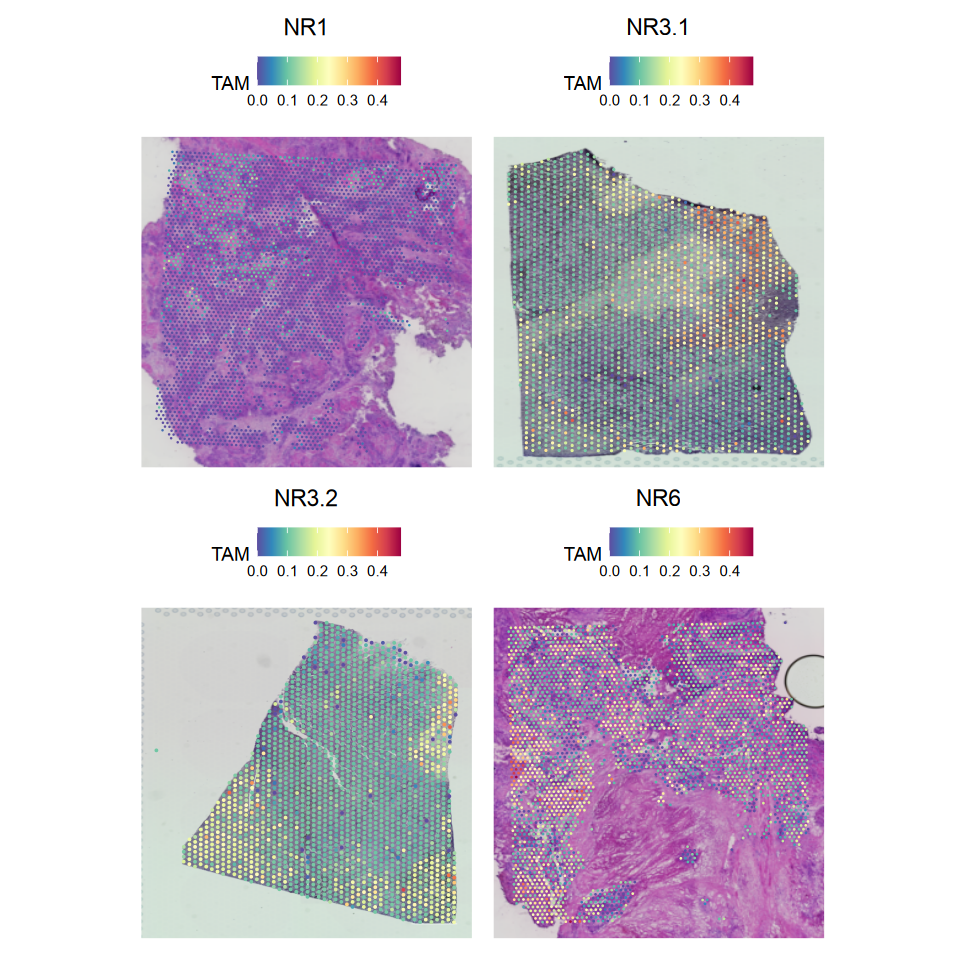

In [107]:
SpatialFeaturePlot(seur_obj, features ="TAM",ncol=2)  & coord_fixed()

Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.
Coordinate system already present. Adding new coordinate system, which will replace the existing one.


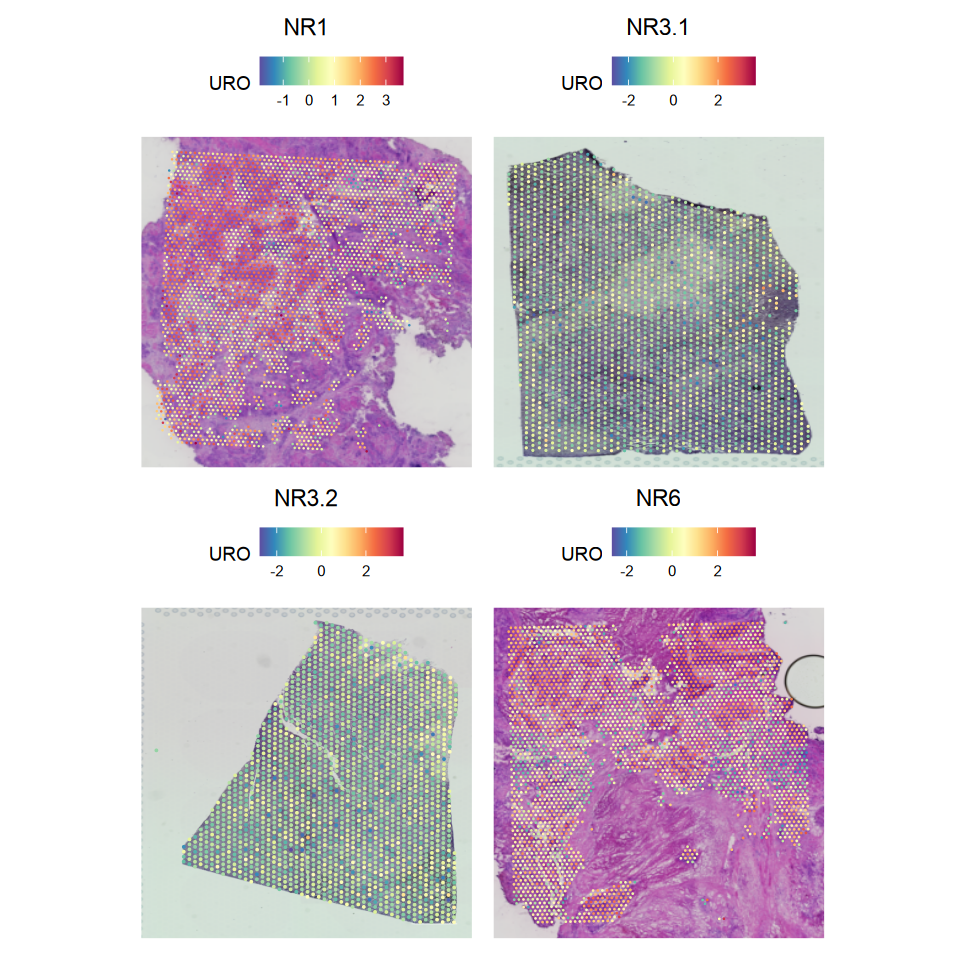

In [108]:
SpatialFeaturePlot(seur_obj, features ="URO",ncol=2)  & coord_fixed()

In [79]:
seur_obj$DMGResistancePAS = LayerData(seur_obj, assay="Pathways",layer="scale.data")["DMGResistance",]

In [82]:
ggplot.df = seur_obj@meta.data[,c("Sample","TempDes", "DMGResistancePAS")]

In [83]:
head(ggplot.df)

,Sample,TempDes,DMGResistancePAS
,<chr>,<chr>,<dbl>
NR1_AACACCTACTATCGAA-1,NR1,EPI,-0.224
NR1_AACACTTGGCAAGGAA-1,NR1,EPI,0.278
NR1_AACAGGCCAACGATTA-1,NR1,EPI,-0.533
NR1_AACAGGTTATTGCACC-1,NR1,STR,0.692
NR1_AACAGTCCACGCGGTG-1,NR1,STR,-0.007
NR1_AACAGTCGTGTCGCGG-1,NR1,EPI,-0.890


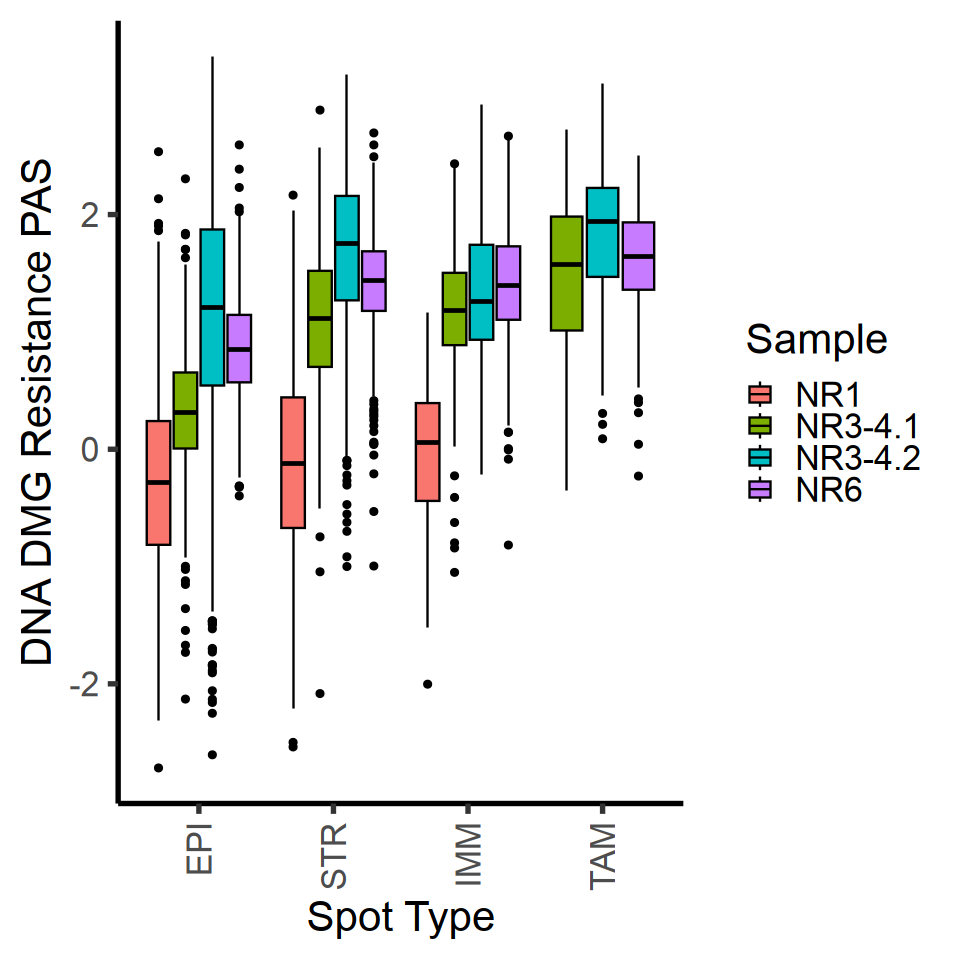

In [88]:
options(repr.plot.width=8,repr.plot.height=8)
ggboxplot(ggplot.df, x = "TempDes",y="DMGResistancePAS",fill="Sample") + xlab("Spot Type") + ylab("DNA DMG Resistance PAS") +
theme_classic(base_size=25) + guides(fill=guide_legend(title="Sample")) + scale_x_discrete(guide = guide_axis(angle = 90))

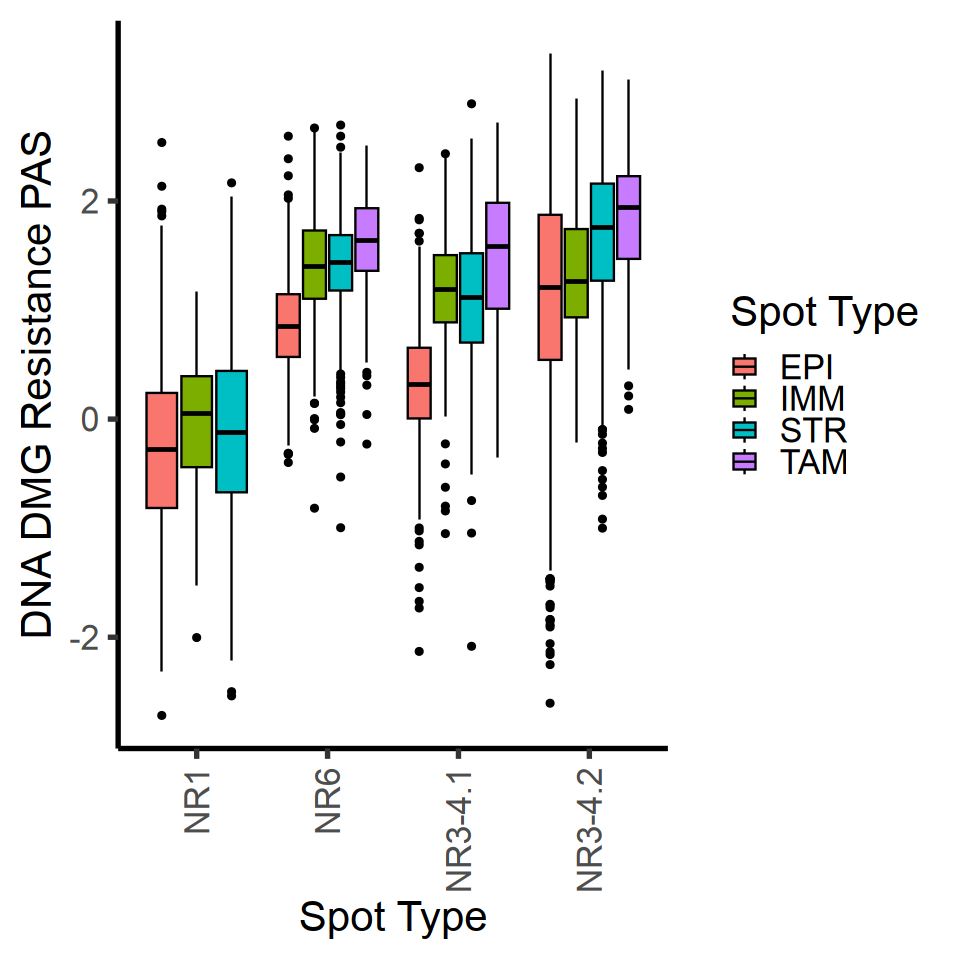

In [89]:
options(repr.plot.width=8,repr.plot.height=8)
ggboxplot(ggplot.df, x = "Sample",y="DMGResistancePAS",fill="TempDes") + xlab("Spot Type") + ylab("DNA DMG Resistance PAS") +
theme_classic(base_size=25) + guides(fill=guide_legend(title="Spot Type")) + scale_x_discrete(guide = guide_axis(angle = 90))

In [84]:
test_proximity <- function(seur_obj, img.choose, thres_x_up,thres_x_down,thres_y_up,thres_y_down,col.choose,ct1,ct2,n_perms){
    #Make initial plot
    coords <- GetTissueCoordinates(seur_obj, image = img.choose)
    coords$Cluster = unlist(seur_obj@meta.data[coords$cell,col.choose])
    print(head(coords))
    p2 <- ggplot(coords) +
      geom_point(aes(y, x,color=Cluster)) +
      coord_fixed()
    
    p2 = p2 + scale_y_reverse() + geom_hline(yintercept = thres_x_up) + geom_hline(yintercept=thres_x_down) + geom_vline(xintercept=thres_y_up) + geom_vline(xintercept = thres_y_down) + xlab("imagecol") + ylab("imagerow")
    
    plot(p2)
    
    #Show specific cell type of interest
    res = GetTissueCoordinates(seur_obj, names(seur_obj@images)[2])[colnames(seur_obj)[unlist(seur_obj[[col.choose]]) == celltype],]
    cells.show = res$cell[res$y > thres_y_up & res$y < thres_y_down & res$x > thres_x_up & res$x < thres_x_down]
    cells.show = cells.show[!is.na(cells.show)]
    coords <- GetTissueCoordinates(seur_obj, image = names(seur_obj@images)[2])
    coords$Cluster = unlist(seur_obj@meta.data[coords$cell,col.choose])
    coords$Highlight="No"

    coords[cells.show,"Highlight"] = "Yes"
    p2 <- ggplot(coords) +
      geom_point(aes(y, x,color=Cluster,shape=Highlight)) +
      coord_fixed()
    p2 = p2 + scale_y_reverse() + geom_hline(yintercept = thres_x_up) + geom_hline(yintercept=thres_x_down) + geom_vline(xintercept=thres_y_up) + geom_vline(xintercept = thres_y_down) + xlab("imagecol") + ylab("imagerow")
    
    plot(p2)
    #Calculate who's in the box
    cells.show = coords[coords$y > thres_y_up & coords$y < thres_y_down & coords$x > thres_x_up & coords$x < thres_x_down,]
    cells.show = cells.show[!is.na(cells.show),]
    coords$InBox = "No"
    coords[rownames(cells.show),"InBox"] = "Yes"
    
    p2 <- ggplot(coords) +
      geom_point(aes(y, x,color=Cluster,shape=InBox)) +
      coord_fixed()
    p2 = p2 + scale_y_reverse() + geom_hline(yintercept = thres_x_up) + geom_hline(yintercept=thres_x_down) + geom_vline(xintercept=thres_y_up) + geom_vline(xintercept = thres_y_down) + xlab("imagecol") + ylab("imagerow")
    
    
    plot(p2)
    #Calculate observed
    obs = coords$Cluster[coords$InBox=="Yes"]
    obs = obs[!is.na(obs)]
    obs = table(obs)
    obs = obs[ct1]/(obs[ct1] + obs[ct2])
    
    
    sample.use = sum(coords$InBox=="Yes")
    epis.all = c()
    tams.all = c()
    print("Starting permutations")
    for(i in seq(1,n_perms)){
        temp.res = table(sample(seur_obj$TempDes[seur_obj$orig.ident == "NR6"],sample.use))
        epis = temp.res[ct1]
        tams = temp.res[ct2]
        epis.all = c(epis.all, epis)
        tams.all = c(tams.all, tams)
    }
    print(gghistogram(tams.all/(epis.all + tams.all),bins=15) + geom_vline(xintercept = obs))
    return(colnames(seur_obj)[unlist(seur_obj[[col.choose]]) == celltype])
}

In [87]:
thres_x_up = 6500
thres_x_down= 7500
thres_y_up = 8500
thres_y_down = 9500
celltype="TAM"
col.choose = "TempDes"
img.choose = names(seur_obj@images)[2]
n_perms= 5000
ct1 = "EPI"
ct2="TAM"

                          x    y                   cell Cluster
NR6_AAACAAGTATCTCCCA-1 7868 5450 NR6_AAACAAGTATCTCCCA-1     EPI
NR6_AAACAGGGTCTATATT-1 2641 5786 NR6_AAACAGGGTCTATATT-1     STR
NR6_AAACCCGAACGAAATC-1 8635 5957 NR6_AAACCCGAACGAAATC-1     IMM
NR6_AAACCGGAAATGTTAA-1 9158 5034 NR6_AAACCGGAAATGTTAA-1     IMM
NR6_AAACCGGGTAGGTACC-1 3525 6292 NR6_AAACCGGGTAGGTACC-1     STR
NR6_AAACCGTTCGTCCAGG-1 4342 5265 NR6_AAACCGTTCGTCCAGG-1     EPI


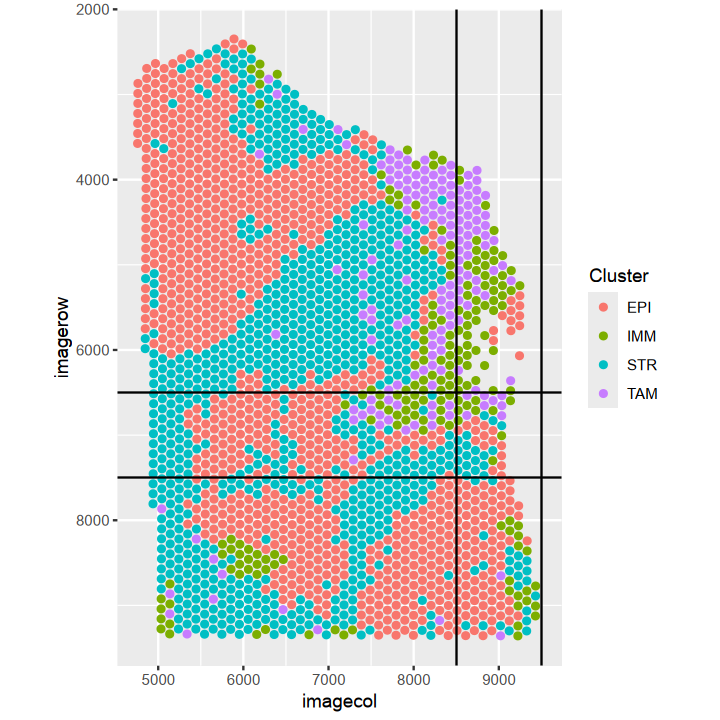

Warning message:
“Removed 208 rows containing missing values or values outside the scale range (`geom_point()`).”


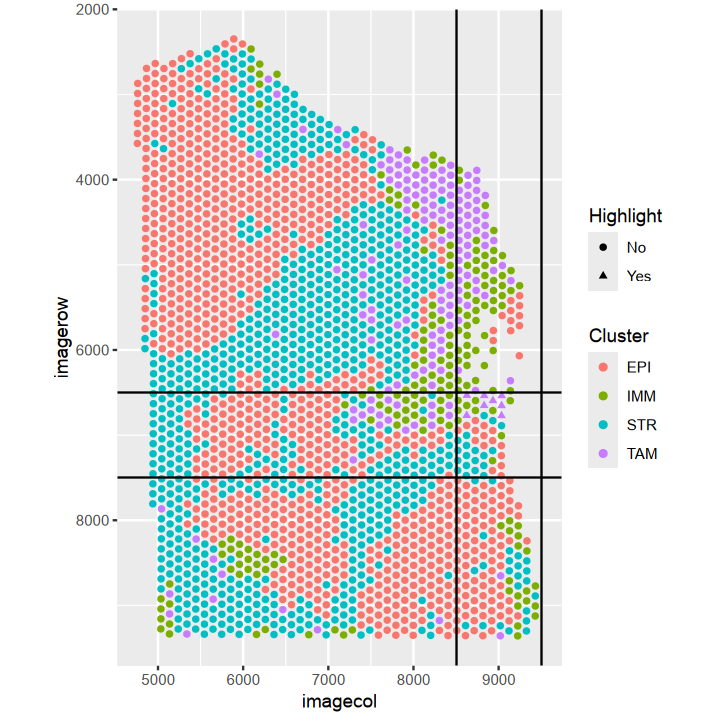

[1] "Starting permutations"


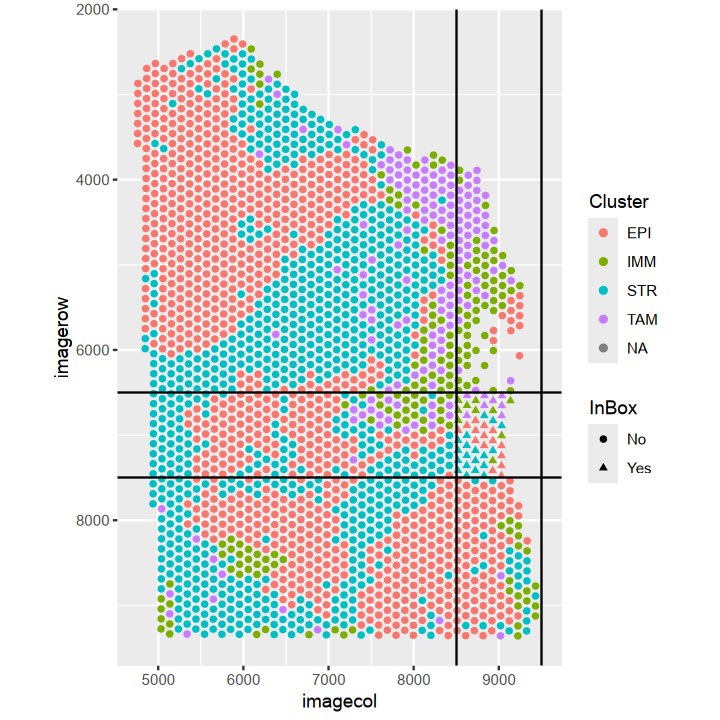

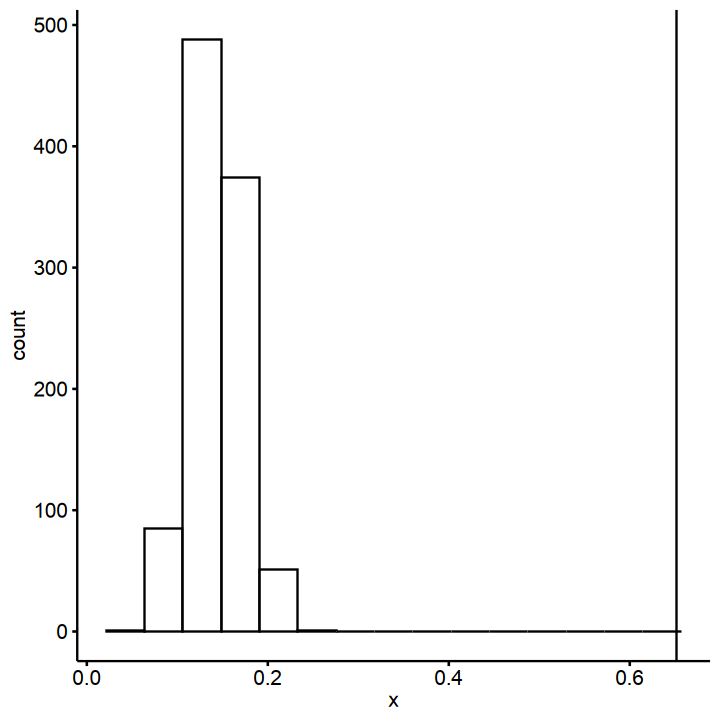

In [88]:
cell_selections = test_proximity(seur_obj,img.choose,thres_x_up,thres_x_down, thres_y_up,thres_y_down,col.choose,ct1,ct2,1000)

In [41]:
seur_obj$Areas = "Uninteresting"
seur_obj@meta.data[cell_selections,"Areas"] = "Interesting"

In [45]:
presto.res = wilcoxauc(seur_obj, "Areas", 
    seurat_assay = "SCT")
presto.res.filtered = presto.res[presto.res$logFC > 0.5 & 
    presto.res$pct_in > 90 & presto.res$pct_in - 
    presto.res$pct_out > 10 & presto.res$padj < 
    0.05, ]
presto.res.split = split(presto.res.filtered, presto.res.filtered$group)
presto.res.split = presto.res.split[gtools::mixedorder(names(presto.res.split))]
presto.res.split = lapply(presto.res.split, function(x) x[order(x$logFC, 
    decreasing = T), ])

In [48]:
lapply(presto.res.split,head,20)

,feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
208,LAPTM5,Interesting,2.128728,1.5514079,2995435,0.9048559,3.439297e-160,4.091781e-157,95.6250,44.51426
3316,CTSB,Interesting,3.019246,1.5425487,2914922,0.8805347,9.297799e-121,4.301782e-118,100.0000,79.61334
7179,IFI30,Interesting,2.069646,1.5352865,2910204,0.8791095,3.018585e-142,1.795627e-139,92.8125,43.72160
5662,B2M,Interesting,2.746971,1.4658829,2694408,0.8139220,1.244758e-84,2.032616e-82,96.8750,68.08120
8140,TIMP1,Interesting,2.429451,1.4166392,2875986,0.8687730,1.764378e-116,6.678972e-114,98.1250,68.03287
2408,CD74,Interesting,2.827591,1.3845406,2795728,0.8445289,2.093509e-99,4.981355e-97,99.3750,79.88400
6339,CD68,Interesting,1.724078,1.3131070,2947849,0.8904812,2.461165e-161,3.416097e-158,93.4375,38.08603
4025,SRGN,Interesting,1.743735,1.2855182,2952120,0.8917712,6.155656e-157,6.408038e-154,93.7500,40.71532
1349,FN1,Interesting,2.772413,1.2347433,2467269,0.7453084,1.204777e-52,6.872180e-51,99.0625,65.39391


In [ ]:
coords <- GetTissueCoordinates(seur_obj, image = names(seur_obj@images)[2])
coords$Cluster = unlist(seur_obj@meta.data[coords$cell,col.choose])
cells <- crawdad::toSF(pos = coords[,c("x", "y")], celltypes =coords$Cluster)
## define the scales to analyze the data
scales <- seq(500,5000,by=500)
## shuffle cells to create null background
shuffle.list <- crawdad:::makeShuffledCells(cells,
                                            scales = scales,
                                            perms = 10,
                                            ncores = 6,
                                            seed = 1,
                                            verbose = TRUE)
## calculate the zscore for the cell-type pairs at different scales
results <- crawdad::findTrends(cells,
                               dist = 500,
                               shuffle.list = shuffle.list,
                               ncores = 10,
                               verbose = TRUE,
                               returnMeans = FALSE)
dat <- crawdad::meltResultsList(results, withPerms = TRUE)
## calculate the zscore for the multiple-test correction
zsig <- correctZBonferroni(dat)


creating `sf` object

shuffling permutation 1 using seed 1

50 unit scale

13254 tiles to shuffle...

shuffling permutation 2 using seed 2

50 unit scale

13254 tiles to shuffle...

shuffling permutation 3 using seed 3

50 unit scale

13254 tiles to shuffle...

shuffling permutation 4 using seed 4

50 unit scale

13254 tiles to shuffle...

shuffling permutation 5 using seed 5

50 unit scale

13254 tiles to shuffle...

shuffling permutation 6 using seed 6

50 unit scale

13254 tiles to shuffle...

shuffling permutation 7 using seed 7

50 unit scale

13395 tiles to shuffle...

shuffling permutation 8 using seed 8

50 unit scale

13395 tiles to shuffle...

shuffling permutation 9 using seed 9

50 unit scale

13395 tiles to shuffle...

shuffling permutation 10 using seed 10

50 unit scale

13490 tiles to shuffle...

shuffling permutation 1 using seed 1

100 unit scale

3337 tiles to shuffle...

shuffling permutation 2 using seed 2

100 unit scale

3337 tiles to shuffle...

shuffling permu

In [354]:
zsig

[1] 2.96

In [355]:
dat

perm,neighbor,Z,scale,reference,id
<int>,<fct>,<dbl>,<dbl>,<chr>,<lgl>
1,EPI,0,100,EPI,NA
2,EPI,0,100,EPI,NA
3,EPI,0,100,EPI,NA
4,EPI,0,100,EPI,NA
5,EPI,0,100,EPI,NA
6,EPI,0,100,EPI,NA
7,EPI,0,100,EPI,NA
8,EPI,0,100,EPI,NA
9,EPI,0,100,EPI,NA


Warning message:
“There was 1 warning in `dplyr::filter()`.
ℹ In argument: `scale == min(scale, na.rm = TRUE)`.
Caused by warning in `min()`:
! no non-missing arguments to min; returning Inf”
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.


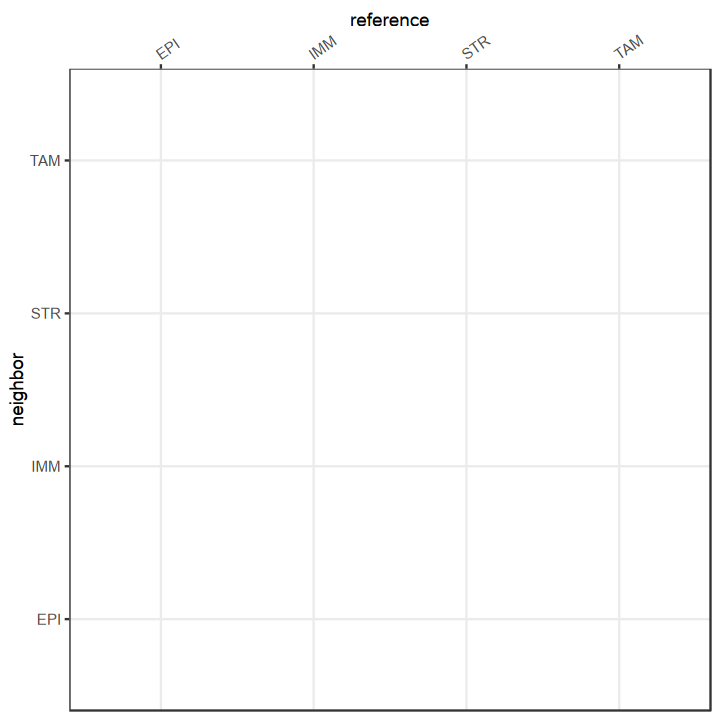

In [353]:
## summary visualization
vizColocDotplot(dat, zsigThresh = zsig, zscoreLimit = 2*zsig) +
  theme(axis.text.x = element_text(angle = 35, h = 0))

In [213]:
spatial_nn = FindNeighbors(as.matrix(GetTissueCoordinates(seur_obj, names(seur_obj@images)[2])[,c(1,2)]),k.param = 11)

Computing nearest neighbor graph

Computing SNN



In [214]:
temp = as.matrix(spatial_nn$nn)[cells.show,]
cells.use = apply(temp,1, function(x){
    colnames(temp[,x > 0])
})
cells.use = unique(cells.use)
desigs.use = seur_obj$TempDes[cells.use]
desigs.use = table(seur_obj$TempDes[cells.use])

In [215]:
desigs.use


EPI IMM STR TAM 
 19  95  57 489 

In [176]:
n_perms = 1000

In [194]:
temp.res


EPI IMM STR TAM 
 50   6  39   5 

In [168]:
epis.all = c()
tams.all = c()
for(i in seq(1,n_perms)){
    temp.res = table(sample(seur_obj$TempDes[seur_obj$orig.ident == "NR6"],100))
    epis = temp.res["EPI"]
    tams = temp.res["TAM"]
    epis.all = c(epis.all, epis)
    tams.all = c(tams.all, tams)
}

Warning message:
“Removed 1 row containing non-finite outside the scale range (`stat_bin()`).”


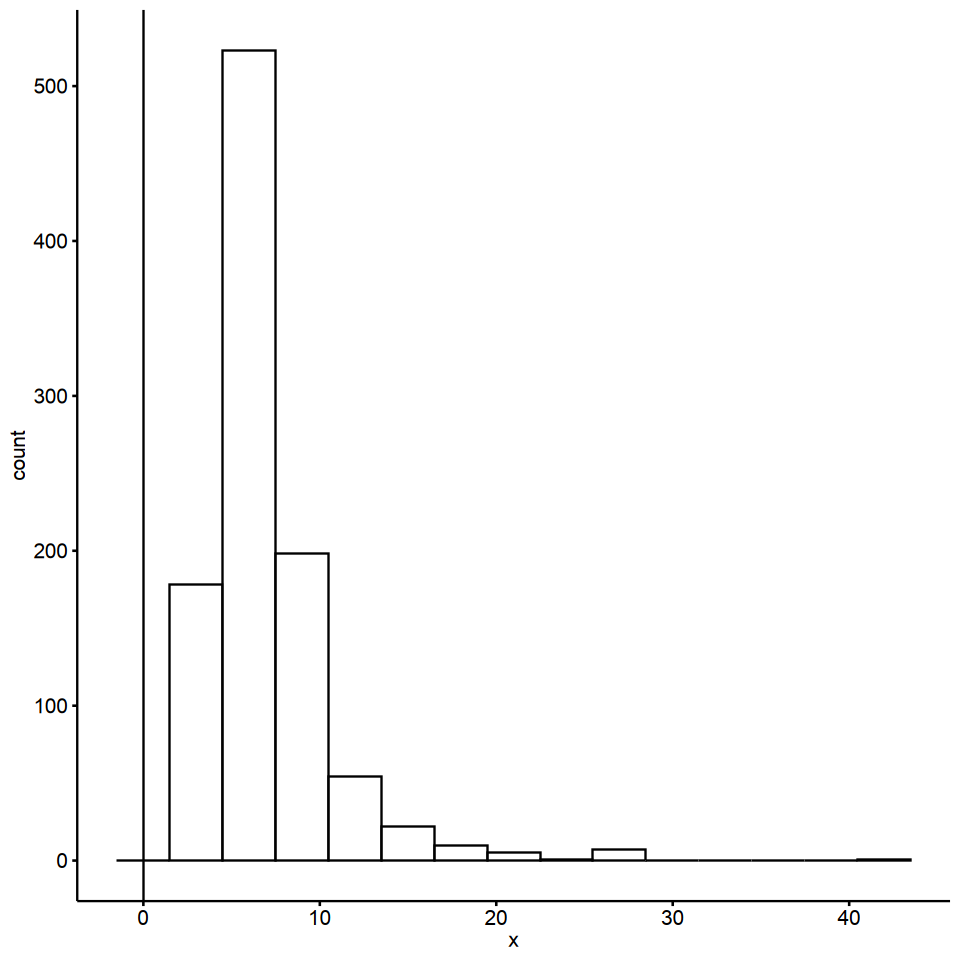

In [189]:
gghistogram(epis.all/tams.all,bins=15) + geom_vline(xintercept = desigs.use["EPI"]/desigs.use["TAM"])

In [131]:
SpatialDimPlot(seur_obj, group.by="TempDes",cells.highlight=cells.show) 

ERROR: Error in levels(data$ident) <- c(order, setdiff(x = levels(x = data$ident), : attempt to set an attribute on NULL


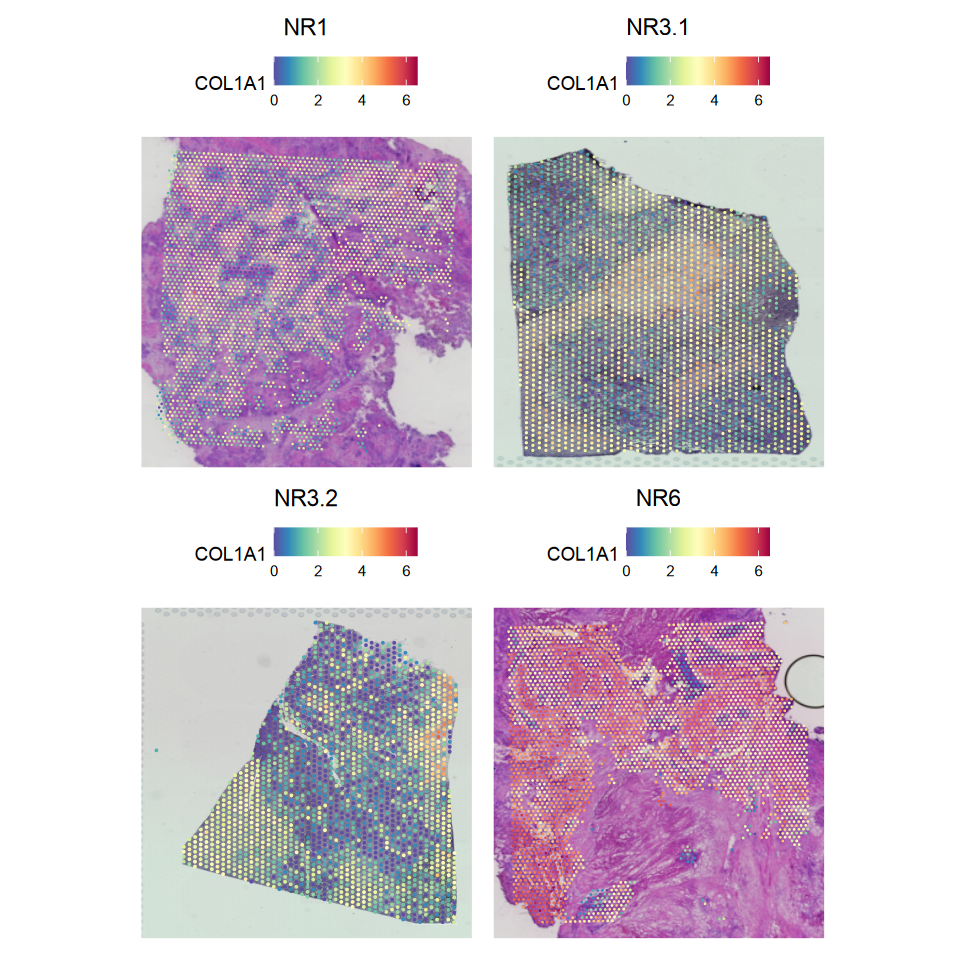

In [39]:
SpatialFeaturePlot(seur_obj, features="COL1A1",ncol=2)

In [43]:
#seur_obj = run_save_object(seur_obj)

In [ ]:
seur_obj = readRDS("2024

In [40]:
graphs.temp = seur_obj@graphs 

In [41]:
seur_obj@graphs = list()

In [42]:
seur_obj@reductions = seur_obj@reductions[!grepl("^X", names(seur_obj@reductions))]

In [6]:
table(seur_obj$Sample,seur_obj$Designation)

ERROR: Error in eval(expr, envir, enclos): object 'seur_obj' not found


In [45]:
library(VoltRon)


Attaching package: ‘VoltRon’


The following object is masked from ‘package:CellChat’:

    normalizeData


The following object is masked from ‘package:scCustomize’:

    as.Seurat


The following object is masked from ‘package:Seurat’:

    as.Seurat


The following object is masked from ‘package:SeuratObject’:

    as.Seurat




In [46]:
volt_obj = as.VoltRon(seur_obj)

Converting FOV: NR1 ...

Converting FOV: NR3.1 ...

Converting FOV: NR3.2 ...

Converting FOV: NR6 ...

Merging object ...

Merging metadata ...

Merging blocks and layers ...



In [47]:
vr_merged_result <- getSpatialNeighbors(volt_obj, method = "delaunay")

In [48]:

temp.meta = Metadata(volt_obj)

In [49]:
temp.meta

,Count,Assay,Layer,Sample,orig.ident,nCount_Spatial,nFeature_Spatial,Batch,Sample.1,Contamination,⋯,cca_snn_res.0.2,cca_clusters,SCT_snn_res.0.2,SCT_clusters,integrated_snn_res.0.2,integrated_clusters,SubCluster,TAM,Designation,TempDes
,<dbl>,<chr>,<chr>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<dbl>,⋯,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<dbl>,<chr>,<chr>
NR1_AACACCTACTATCGAA-1_Assay1,4013,FOV,Section1,NR1,NR1,5631,2965,NR1,NR1,0.0036504983,⋯,1,1,4,4,0,0,0_1,0.000000000,STR,EPI
NR1_AACACTTGGCAAGGAA-1_Assay1,4079,FOV,Section1,NR1,NR1,8355,3719,NR1,NR1,0.0064131900,⋯,1,1,4,4,0,0,0_1,0.082793959,EPI,EPI
NR1_AACAGGCCAACGATTA-1_Assay1,2489,FOV,Section1,NR1,NR1,885,700,NR1,NR1,0.0160945104,⋯,1,1,4,4,0,0,0_1,0.000000000,STR,EPI
NR1_AACAGGTTATTGCACC-1_Assay1,3704,FOV,Section1,NR1,NR1,20956,6448,NR1,NR1,0.0089133283,⋯,3,3,4,4,2,2,2_0,0.013754045,MYEL,STR
NR1_AACAGTCCACGCGGTG-1_Assay1,2828,FOV,Section1,NR1,NR1,1750,1056,NR1,NR1,0.0137274730,⋯,2,2,5,5,1,1,1_1,0.065533981,STR,STR
NR1_AACAGTCGTGTCGCGG-1_Assay1,3439,FOV,Section1,NR1,NR1,12111,4488,NR1,NR1,0.0041467308,⋯,1,1,4,4,5,5,5_0,0.000000000,STR,EPI
NR1_AACATATTCTTGCGAA-1_Assay1,3633,FOV,Section1,NR1,NR1,45300,8015,NR1,NR1,0.0014524678,⋯,5,5,4,4,5,5,5_1,0.087108954,EPI,EPI
NR1_AACATCGCGTGACCAC-1_Assay1,3495,FOV,Section1,NR1,NR1,12541,4282,NR1,NR1,0.0028942396,⋯,0,0,0,0,0,0,0_2,0.000000000,STR,EPI
NR1_AACATCTTAAGGCTCA-1_Assay1,2971,FOV,Section1,NR1,NR1,3089,1184,NR1,NR1,0.0080141309,⋯,2,2,5,5,1,1,1_1,0.036138080,STR,STR


In [50]:
neighborhood_results <- vrNeighbourhoodEnrichment(vr_merged_result, group.by = "Designation")

Testing Neighborhood Enrichment of 'Designation' for 'Assay1'

Warning message in data.frame(neigh_results[[assy]], AssayID = assy, SampleMetadata(object_subset)):
“row names were found from a short variable and have been discarded”
Testing Neighborhood Enrichment of 'Designation' for 'Assay2'

Warning message in data.frame(neigh_results[[assy]], AssayID = assy, SampleMetadata(object_subset)):
“row names were found from a short variable and have been discarded”
Testing Neighborhood Enrichment of 'Designation' for 'Assay3'

Warning message in data.frame(neigh_results[[assy]], AssayID = assy, SampleMetadata(object_subset)):
“row names were found from a short variable and have been discarded”
Testing Neighborhood Enrichment of 'Designation' for 'Assay4'

Warning message in data.frame(neigh_results[[assy]], AssayID = assy, SampleMetadata(object_subset)):
“row names were found from a short variable and have been discarded”


In [51]:
neighborhood_results[neighborhood_results$from_value == "TAM",]

,from_value,to_value,p_assoc,p_segreg,value,p_assoc_adj,p_segreg_adj,n_from,n_to,AssayID,Assay,Layer,Sample
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<table>,<table>,<chr>,<chr>,<chr>,<chr>
Assay2.13,TAM,EPI,1.00000000,0.0000000,-3.55319217,1.0000000,0.0000000,247,838,Assay2,FOV,Section1,NR3.1
Assay2.14,TAM,MYEL,1.00000000,0.0000000,-1.43594725,1.0000000,0.0000000,247,908,Assay2,FOV,Section1,NR3.1
Assay2.15,TAM,STR,1.00000000,0.0000000,-0.79053119,1.0000000,0.0000000,247,221,Assay2,FOV,Section1,NR3.1
Assay2.16,TAM,TAM,0.00000000,1.0000000,2.02879101,0.0000000,1.0000000,247,247,Assay2,FOV,Section1,NR3.1
Assay3.13,TAM,EPI,0.86500000,0.0620000,-0.29395779,0.8650000,0.1240000,5,987,Assay3,FOV,Section1,NR3.2
Assay3.14,TAM,MYEL,0.46100000,0.3980000,-0.03424038,0.6146667,0.5306667,5,803,Assay3,FOV,Section1,NR3.2
Assay3.15,TAM,STR,0.05016009,0.8740662,0.57093899,0.1003202,0.8740662,5,178,Assay3,FOV,Section1,NR3.2
Assay3.16,TAM,TAM,0.00000000,0.0000000,0.00000000,0.0000000,0.0000000,5,5,Assay3,FOV,Section1,NR3.2
Assay4.13,TAM,EPI,0.94501018,0.0000000,-1.38246831,1.0000000,0.0000000,4,492,Assay4,FOV,Section1,NR6


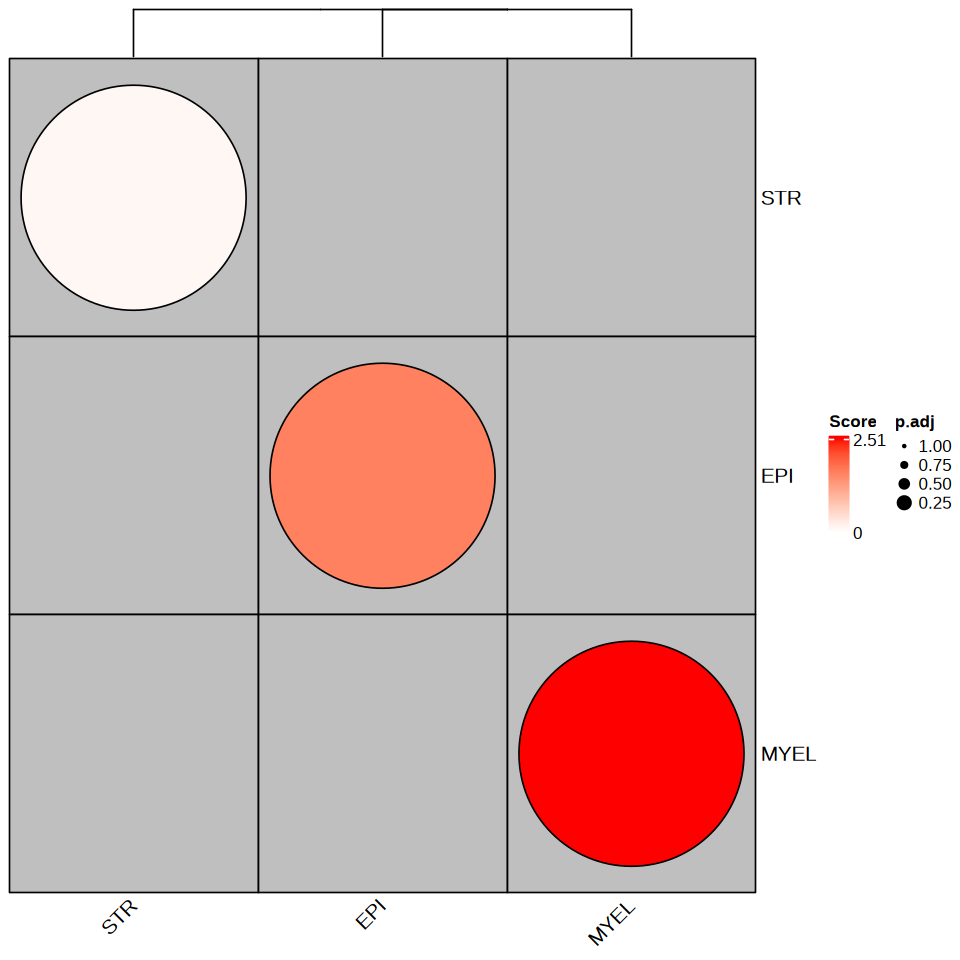

In [61]:
vrNeighbourhoodEnrichmentPlot(neighborhood_results, assay = "Assay1", type = "assoc")

In [81]:
SampleMetadata(volt_obj)

,Assay,Layer,Sample
,<chr>,<chr>,<chr>
Assay1,FOV,Section1,NR1
Assay2,FOV,Section1,NR6
Assay3,FOV,Section1,NR3.4.1
Assay4,FOV,Section1,NR3.4.2


In [90]:
VoltRon::annotateSpatialData

function (object, label = "annotation", assay = NULL, use.image = FALSE, 
    image_name = NULL, channel = NULL, ...) 
{
    if (!inherits(object, "VoltRon")) 
        stop("Please provide a VoltRon object!")
    sample_metadata <- SampleMetadata(object)
    assay_names <- vrAssayNames(object, assay = assay)
    if (length(assay_names) > 0) 
        assay <- assay_names[1]
    metadata <- Metadata(object, assay = sample_metadata[assay, 
        "Assay"])
    coords <- vrCoordinates(object, assay = assay)
    if (label %in% colnames(metadata)) {
        unique_names <- make.unique(c(colnames(metadata)[grepl(paste0("^", 
            label), colnames(metadata))], label))
        label <- unique_names[length(unique_names)]
    }
    if (is.null(image_name)) {
        image_name <- vrMainSpatial(object[[assay]])
    }
    if (use.image) {
        g <- magick::image_ggplot(vrImages(object, assay = assay, 
            name = image_name, channel = channel)) + labs(title = "")
    }
    else {
        g <- vrSpatialPlot(object, assay = assay, background = c(image_name, 
            channel), scale.image = FALSE, ...) + labs(title = "")
    }
    if (interactive()) {
        ui <- fluidPage(sidebarLayout(position = "left", sidebarPanel(tags$style(make_css(list(".well", 
            "margin", "7%"))), tags$script(HTML("\n            $('#plot').mousedown(function(e) {\n                var parentOffset = $(this).offset();\n                var relX = e.pageX - parentOffset.left;\n                var relY = e.pageY - parentOffset.top;\n                Shiny.setInputValue('x1', relX);\n                Shiny.setInputValue('y1', relY);\n            }).mouseup(function(e) {\n                var parentOffset = $(this).offset();\n                var relX = e.pageX - parentOffset.left;\n                var relY = e.pageY - parentOffset.top;\n                Shiny.setInputValue('x2', relX);\n                Shiny.setInputValue('y2', relY);\n                Shiny.setInputValue('action', Math.random());\n            });\n          ")), 
            fluidRow(column(12, h4("Annotation Interface")), 
                ), br(), fluidRow(column(12, shiny::actionButton("reset_btn", 
                "Reset Points")), column(12, shiny::actionButton("rmvlast_btn", 
                "Remove Last Point")), column(12, shiny::actionButton("addregion_btn", 
                "Add Region")), ), br(), fluidRow(column(12, 
                h4("Selected Regions")), column(12, sliderInput("alpha", 
                "Transparency", min = 0, max = 1, value = 0.2)), 
                br(), column(12, uiOutput("textbox_ui")), br(), 
                br()), fluidRow(column(12, h4("Finished Selecting?")), 
                column(12, shiny::actionButton("done", "Yes!"))), 
            width = 4), mainPanel(shinyjs::useShinyjs(), plotOutput("image_plot", 
            height = "1000px", click = "plot_click", dblclick = "plot_dblclick", 
            brush = brushOpts(id = "plot_brush", fill = "green", 
                resetOnNew = TRUE)), width = 8)))
        server <- function(input, output) {
            selected_corners <- reactiveVal(data.frame(x = numeric(0), 
                y = numeric(0)))
            selected_corners_list <- reactiveVal(list())
            ranges <- reactiveValues(x = g$coordinates$limits$x, 
                y = g$coordinates$limits$y)
            observeEvent(input$plot_dblclick, {
                brush <- input$plot_brush
                if (!is.null(brush)) {
                  ranges$x <- c(brush$xmin, brush$xmax)
                  ranges$y <- c(brush$ymin, brush$ymax)
                }
                else {
                  ranges$x <- g$coordinates$limits$x
                  ranges$y <- g$coordinates$limits$y
                }
            })
            observeEvent(input$plot_click, {
                brush <- input$plot_brush
                if (is.null(brush)) {
                  click <- input$plot_click
                  x <- click$x
                  

In [91]:
library(shinyjs)
library(tableHTML)
library(shiny)
annotateSpatialData <- function (object, label = "annotation", assay = NULL, use.image = FALSE, 
    image_name = NULL, channel = NULL, ...) 
{
    if (!inherits(object, "VoltRon")) 
        stop("Please provide a VoltRon object!")
    sample_metadata <- SampleMetadata(object)
    assay_names <- vrAssayNames(object, assay = assay)
    if (length(assay_names) > 0) 
        assay <- assay_names[1]
    metadata <- Metadata(object, assay = sample_metadata[assay, 
        "Assay"])
    coords <- vrCoordinates(object, assay = assay)
    if (label %in% colnames(metadata)) {
        unique_names <- make.unique(c(colnames(metadata)[grepl(paste0("^", 
            label), colnames(metadata))], label))
        label <- unique_names[length(unique_names)]
    }
    if (is.null(image_name)) {
        image_name <- vrMainSpatial(object[[assay]])
    }
    if (use.image) {
        g <- magick::image_ggplot(vrImages(object, assay = assay, 
            name = image_name, channel = channel)) + labs(title = "")
    }
    else {
        g <- vrSpatialPlot(object, assay = assay, background = c(image_name, 
            channel), scale.image = FALSE, ...) + labs(title = "")
    }
    ui <- fluidPage(sidebarLayout(position = "left", sidebarPanel(tags$style(make_css(list(".well", 
        "margin", "7%"))), tags$script(HTML("\n            $('#plot').mousedown(function(e) {\n                var parentOffset = $(this).offset();\n                var relX = e.pageX - parentOffset.left;\n                var relY = e.pageY - parentOffset.top;\n                Shiny.setInputValue('x1', relX);\n                Shiny.setInputValue('y1', relY);\n            }).mouseup(function(e) {\n                var parentOffset = $(this).offset();\n                var relX = e.pageX - parentOffset.left;\n                var relY = e.pageY - parentOffset.top;\n                Shiny.setInputValue('x2', relX);\n                Shiny.setInputValue('y2', relY);\n                Shiny.setInputValue('action', Math.random());\n            });\n          ")), 
        fluidRow(column(12, h4("Annotation Interface")), 
            ), br(), fluidRow(column(12, shiny::actionButton("reset_btn", 
            "Reset Points")), column(12, shiny::actionButton("rmvlast_btn", 
            "Remove Last Point")), column(12, shiny::actionButton("addregion_btn", 
            "Add Region")), ), br(), fluidRow(column(12, 
            h4("Selected Regions")), column(12, sliderInput("alpha", 
            "Transparency", min = 0, max = 1, value = 0.2)), 
            br(), column(12, uiOutput("textbox_ui")), br(), 
            br()), fluidRow(column(12, h4("Finished Selecting?")), 
            column(12, shiny::actionButton("done", "Yes!"))), 
        width = 4), mainPanel(shinyjs::useShinyjs(), plotOutput("image_plot", 
        height = "1000px", click = "plot_click", dblclick = "plot_dblclick", 
        brush = brushOpts(id = "plot_brush", fill = "green", 
            resetOnNew = TRUE)), width = 8)))
    server <- function(input, output) {
        selected_corners <- reactiveVal(data.frame(x = numeric(0), 
            y = numeric(0)))
        selected_corners_list <- reactiveVal(list())
        ranges <- reactiveValues(x = g$coordinates$limits$x, 
            y = g$coordinates$limits$y)
        observeEvent(input$plot_dblclick, {
            brush <- input$plot_brush
            if (!is.null(brush)) {
              ranges$x <- c(brush$xmin, brush$xmax)
              ranges$y <- c(brush$ymin, brush$ymax)
            }
            else {
              ranges$x <- g$coordinates$limits$x
              ranges$y <- g$coordinates$limits$y
            }
        })
        observeEvent(input$plot_click, {
            brush <- input$plot_brush
            if (is.null(brush)) {
              click <- input$plot_click
              x <- click$x
              y <- click$y
              new_point <- data.frame(x = x, y = y)
              selected_corners(rbind(selected_corners(), 
                new_point))
            }
        })
        observeEvent(input$reset_btn, {
            selected_corners(data.frame(x = numeric(0), y = numeric(0)))
        })
        observeEvent(input$rmvlast_btn, {
            selected_corners(selected_corners()[-nrow(selected_corners()), 
              ])
        })
        observeEvent(input$addregion_btn, {
            if (nrow(selected_corners()) > 3) {
              selected_corners_list(c(selected_corners_list(), 
                list(selected_corners())))
              selected_corners(data.frame(x = numeric(0), 
                y = numeric(0)))
              counter$n <- counter$n + 1
            }
        })
        counter <- reactiveValues(n = 0)
        output$textbox_ui <- renderUI({
            textboxes()
        })
        textboxes <- reactive({
            n <- counter$n
            if (n > 0) {
              lapply(seq_len(n), function(i) {
                column(12, textInput(inputId = paste0("region", 
                  i), label = paste0("Region ", i), value = input[[paste0("region", 
                  i)]]))
              })
            }
        })
        output$image_plot <- renderPlot({
            if (length(selected_corners_list()) > 0) {
              for (i in 1:length(selected_corners_list())) {
                cur_corners <- selected_corners_list()[[i]]
                g <- g + ggplot2::geom_polygon(aes(x = x, 
                  y = y, group = "region"), data = cur_corners, 
                  alpha = input$alpha, color = "red")
              }
            }
            g <- g + ggplot2::geom_point(aes(x = x, y = y), 
              data = selected_corners(), color = "red", shape = 16) + 
              coord_equal(xlim = ranges$x, ylim = ranges$y, 
                ratio = 1)
            datax_label_ind <- length(selected_corners_list()) + 
              1
            g <- g + ggplot2::geom_polygon(aes(x = x, y = y), 
              data = selected_corners(), alpha = input$alpha, 
              color = "red")
            if (length(selected_corners_list()) > 0) {
              for (i in 1:length(selected_corners_list())) {
                cur_corners <- selected_corners_list()[[i]]
                cur_corners <- data.frame(x = mean(cur_corners[, 
                  1]), y = max(cur_corners[, 2]), region = paste("Region ", 
                  i))
                g <- g + ggrepel::geom_label_repel(mapping = aes(x = x, 
                  y = y, label = region), data = cur_corners, 
                  size = 5, direction = "y", nudge_y = 6, 
                  box.padding = 0, label.padding = 1, seed = 1, 
                  color = "red")
              }
            }
            g
        })
        observeEvent(input$done, {
            selected_polygon_list <- selected_corners_list()
            selected_label_list <- sapply(1:length(selected_polygon_list), 
              function(i) input[[paste0("region", i)]])
            if (length(selected_corners_list()) == 0) {
              showNotification("You have not annotated the data yet!")
            }
            else if (any(selected_label_list == "")) {
              showNotification("Some regions have blank annotations (empty labels!)")
            }
            else {
              if (inherits(metadata, "data.table")) {
                spatialpoints <- metadata$id
              }
              else {
                spatialpoints <- rownames(metadata)
              }
              new_label <- rep("undefined", length(spatialpoints))
              names(new_label) <- spatialpoints
              result_list <- list()
              for (i in 1:length(selected_polygon_list)) {
                cur_poly <- selected_polygon_list[[i]]
                in.list <- sp::point.in.polygon(coords[, 
                  1], coords[, 2], cur_poly[, 1], cur_poly[, 
                  2])
                new_label[rownames(coords)[!!in.list]] <- selected_label_list[i]
              }
              metadata[[label]] <- new_label
              Metadata(object, assay = sample_metadata[assay, 
                "Assay"]) <- metadata
              segments <- list()
              for (i in 1:length(selected_label_list)) {
                segments[[selected_label_list[i]]] <- data.frame(id = i, 
                  selected_polygon_list[[i]])
              }
              coords <- t(sapply(segments, function(seg) {
                apply(seg[, c("x", "y")], 2, mean)
              }, simplify = TRUE))
              new_assay <- formAssay(coords = coords, segments = segments, 
                type = "ROI", image = vrImages(object, assay = assay), 
                main_image = vrMainImage(object[[assay]]), 
                name = assay)
              object <- addAssay.VoltRon(object, assay = new_assay, 
                metadata = data.frame(check.rows = FALSE, 
                  row.names = rownames(coords)), assay_name = "ROIAnnotation", 
                sample = sample_metadata[assay, "Sample"], 
                layer = sample_metadata[assay, "Layer"])
              stopApp(object)
            }
        })
    }
    shiny::runApp(shiny::shinyApp(ui, server),launch.browser = F,port = 17112)
}

In [92]:
annot_sec <- annotateSpatialData(volt_obj, group.by = "Designation", label = "annotation",assay="Assay2")


Listening on http://127.0.0.1:17112

